In [1]:
# Load packages.
library(Seurat)
library(ggplot2)
library(patchwork)
library(scales)
library(dplyr)
library(reshape2)
library(mixtools)
library(SeuratDisk)
library(data.table)

# Setup custom theme for plotting.
custom_theme <- theme(
  plot.title = element_text(size=16, hjust = 0.5), 
  legend.key.size = unit(0.7, "cm"), 
  legend.text = element_text(size = 14))

The legacy packages maptools, rgdal, and rgeos, underpinning the sp package,
which was just loaded, will retire in October 2023.
Please refer to R-spatial evolution reports for details, especially
https://r-spatial.org/r/2023/05/15/evolution4.html.
It may be desirable to make the sf package available;
package maintainers should consider adding sf to Suggests:.
The sp package is now running under evolution status 2
     (status 2 uses the sf package in place of rgdal)

Attaching SeuratObject


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Warning message:
“package ‘mixtools’ was built under R version 4.2.3”
mixtools package, version 2.0.0, Released 2022-12-04
This package is based upon work supported by the National Science Foundation under Grant No. SES-0518772 and the Chan Zuckerberg Initiative: Essential Open Source Software for Sci

In [125]:
# # load all samples from H5 from end of 05_# dasa1 <- readRDS('{PATH_1}')# dasa2 <- readRDS('{PATH_2}')# dmso1 <- readRDS('{PATH_3}')# dmso2 <- readRDS('{PATH_4}')### load samples dasa1 <- LoadH5Seurat('{PATH_5}', verbose=F)dasa2 <- LoadH5Seurat('{PATH_6}', verbose=F)dmso1 <- LoadH5Seurat('{PATH_7}', verbose=F)dmso2 <- LoadH5Seurat('{PATH_8}', verbose=F)

Validating h5Seurat file



Validating h5Seurat file

Validating h5Seurat file

Validating h5Seurat file



In [ ]:
# load calls per sampledasa1_calls <- readRDS('{PATH_9}')dasa2_calls <- readRDS('{PATH_10}')dmso1_calls <- readRDS('{PATH_11}')dmso2_calls <- readRDS('{PATH_12}')

In [78]:
# # convert all to h5ad# Convert('{PATH_13}')# Convert('{PATH_14}')# Convert('{PATH_15}')# Convert('{PATH_16}')

# Guidecapture Classification

In [189]:
##################
# Assign a guide to each cell, appends new col to sobj@metadata called guidecapture_classification
# Inputs:
# sobj: sobj containing singlets from new guide caller notebook
# call_df: unfiltered df of calls from new guide caller notebook
# returns:
# sobj: sobj with new metadata col with guidecapture information
##################
assign_guides <- function(sobj, call_df){
  # Filter call_df so that it only has cells with 1 <= guide <= 2
  call_df <- call_df[!(rowSums(call_df) > 2 | rowSums(call_df) < 1), ]
  # add column with values = colnames where True with _ as sep
  call_df$results <- apply(call_df, MARGIN = 1, FUN = get_true_cols)
  # drop -n from guide names for easy pattern matching
  call_df$filter_col <- gsub("-[12]", "", call_df$results)
  # Create a mask to only keep cells with one guide or two guides from the same gene
  mask <- sapply(call_df$filter_col, check_condition)
  # apply mask and drop filter_col
  filtered_df <- call_df[mask, 1:ncol(call_df)-1]
  # subset sobj so that it only has cells that have calls
  sobj <- sobj[,Cells(sobj) %in% rownames(filtered_df)]
  # check barcodes to make sure theyre the same order
  if(all(Cells(sobj) == rownames(filtered_df))){
    sobj$guidecapture_classification <- filtered_df$results
    return(sobj)
  }
  # handle case where barcodes are no longer in the correct order
  # to do: add sort
  else {
     print("Barcodes out of order!")
  }
}

### Helper functions
# function to get column names for TRUE values
get_true_cols <- function(row) {
    true_cols <- names(row)[row == TRUE]
    paste(true_cols, collapse = "_")
}

# function to check cells with single guides or guides of the same gene
check_condition <- function(item) {
  # check if "_" is not present
  if (!grepl("_", item)) {
    return(TRUE)
  }
  # split the string by "_"
  parts <- unlist(strsplit(item, "_"))
  # return TRUE if both parts are identical, otherwise return FALSE
  return(parts[1] == parts[2])
}
###

In [195]:
dasa1 <- assign_guides(dasa1, dasa1_calls)
dasa2 <- assign_guides(dasa2, dasa2_calls)
dmso1 <- assign_guides(dmso1, dmso1_calls)
dmso2 <- assign_guides(dmso2, dmso2_calls)

In [196]:
table(dasa1$guidecapture_classification)


           ADNP-1     ADNP-1_ADNP-2            ADNP-2            CHD2-1 
               35                19                22                85 
    CHD2-1_CHD2-2            CHD2-2           CNOT2-1         GPBP1L1-1 
              121                29                34               134 
           HIC2-1     HIC2-1_HIC2-2            HIC2-2           KMT2B-2 
               97               179                49               150 
            MNT-1       MNT-1_MNT-2             MNT-2           NTC28-1 
               91               150                48                66 
  NTC28-1_NTC28-2           NTC28-2           NTC36-1           NTC74-2 
              164                73               240               274 
          NTC82-1           NTC98-2           PIAS1-1   PIAS1-1_PIAS1-2 
              382               117                50               137 
          PIAS1-2          PLAGL2-1 PLAGL2-1_PLAGL2-2          PLAGL2-2 
               54                61               

In [197]:
print(dasa1)
print(dasa2)
print(dmso1)
print(dmso2)

An object of class Seurat 
240716 features across 4044 samples within 3 assays 
Active assay: SCT (22035 features, 3000 variable features)
 2 other assays present: ATAC, RNA
 5 dimensional reductions calculated: lsi, umap.atac, wnn.umap, pca, umap.rna
An object of class Seurat 
241875 features across 4611 samples within 3 assays 
Active assay: SCT (22201 features, 3000 variable features)
 2 other assays present: ATAC, RNA
 5 dimensional reductions calculated: lsi, umap.atac, wnn.umap, pca, umap.rna
An object of class Seurat 
278472 features across 3146 samples within 3 assays 
Active assay: SCT (21309 features, 3000 variable features)
 2 other assays present: ATAC, RNA
 5 dimensional reductions calculated: lsi, umap.atac, wnn.umap, pca, umap.rna
An object of class Seurat 
269563 features across 3838 samples within 3 assays 
Active assay: SCT (22291 features, 3000 variable features)
 2 other assays present: ATAC, RNA
 5 dimensional reductions calculated: lsi, umap.atac, wnn.umap, pca, u

## Regress out cell-cycle genes for clustering

In [198]:
# A list of cell cycle markers, from Tirosh et al, 2015, is loaded with Seurat.  We can
# segregate this list into markers of G2/M phase and markers of S phase
s.genes <- cc.genes$s.genes
g2m.genes <- cc.genes$g2m.genes

In [199]:
# function to test dims for umap
umap_dim_test <- function(sobj, dims_to_test = c(20,25,30,35,40), return_obj = FALSE, return_dim = 30){
    if(!return_obj){
        for(dim in dims_to_test){
            sobj <- RunPCA(sobj, verbose = FALSE)
            sobj <- RunUMAP(sobj, dims = 1:dim, verbose = FALSE, name = "sct.umap")
            sobj <- FindNeighbors(sobj, dims = 1:dim, verbose = FALSE)
            sobj <- FindClusters(sobj, verbose = FALSE)
            print(DimPlot(sobj, reduction="umap", group.by = "Phase") + ggtitle(paste0(dim, " dims, Phase clusters")))
            print(DimPlot(sobj, reduction="umap") + ggtitle(paste0(dim, " dims, Leiden clusters")))
        }
    }
    else{
        sobj <- RunPCA(sobj, verbose = FALSE)
        sobj <- RunUMAP(sobj, dims = 1:return_dim, verbose = FALSE)
        sobj <- FindNeighbors(sobj, dims = 1:return_dim, verbose = FALSE)
        sobj <- FindClusters(sobj, verbose = FALSE)
        return(sobj)
    }
}

In [200]:
# function that regresses out cell cycle genes
# takes sobj and cell cycle genes as input
regress_cell_cycle_genes <- function(sobj, s.genes = cc.genes$s.genes, g2m.genes = cc.genes$g2m.genes){
    DefaultAssay(sobj) <- "RNA"
    # store mitochondrial percentage in object meta data
    sobj <- PercentageFeatureSet(sobj, pattern = "^MT-", col.name = "percent.mt")
    # run sctransform
    sobj <- SCTransform(sobj, vars.to.regress = "percent.mt", verbose = FALSE)
    # cell cycle scoring
    sobj <- CellCycleScoring(sobj, 
        s.features = s.genes, 
        g2m.features = g2m.genes, 
        set.ident = TRUE)
    # Visualize the distribution of cell cycle markers across
    options(repr.plot.width = 12, repr.plot.height = 8)
    print(RidgePlot(sobj, features = c("PCNA", "TOP2A", "MCM6", "MKI67"), ncol = 2))
    # Running a PCA on cell cycle genes reveal
    sobj <- RunPCA(sobj, features = c(s.genes, g2m.genes))
    print(DimPlot(sobj, group.by = "Phase"))
    # rerun sctransform
    sobj <- SCTransform(sobj, 
        vars.to.regress = c("S.Score", "G2M.Score"), 
        verbose = FALSE)
    DefaultAssay(sobj) <- "SCT"
    # run function to compare different umap dims for our samples
    umap_dim_test(sobj)
    return(sobj)
}

Warning message:
“The following features are not present in the object: MLF1IP, not searching for symbol synonyms”
Warning message:
“The following features are not present in the object: UBE2C, FAM64A, HN1, not searching for symbol synonyms”
Picking joint bandwidth of 0.0849

Picking joint bandwidth of 0.121

Picking joint bandwidth of 0.0361

Picking joint bandwidth of 0.0817

Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 38 features requested have not been scaled (running reduction without them): FEN1, MCM2, UNG, GINS2, MCM6, UHRF1, MLF1IP, RFC2, RPA2, SLBP, UBR7, MSH2, RAD51, TIPIN, DSCC1, CASP8AP2, USP1, CHAF1B, E2F8, UBE2C, FAM64A, CKAP2L, HJURP, CDCA3, HN1, TTK, RANGAP1, NCAPD2, ECT2, AURKA, PSRC1, LBR, CKAP5, CTCF, NEK2, G2E3, GAS2L3, CENPA”
Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”
Warning message:
“Requested num

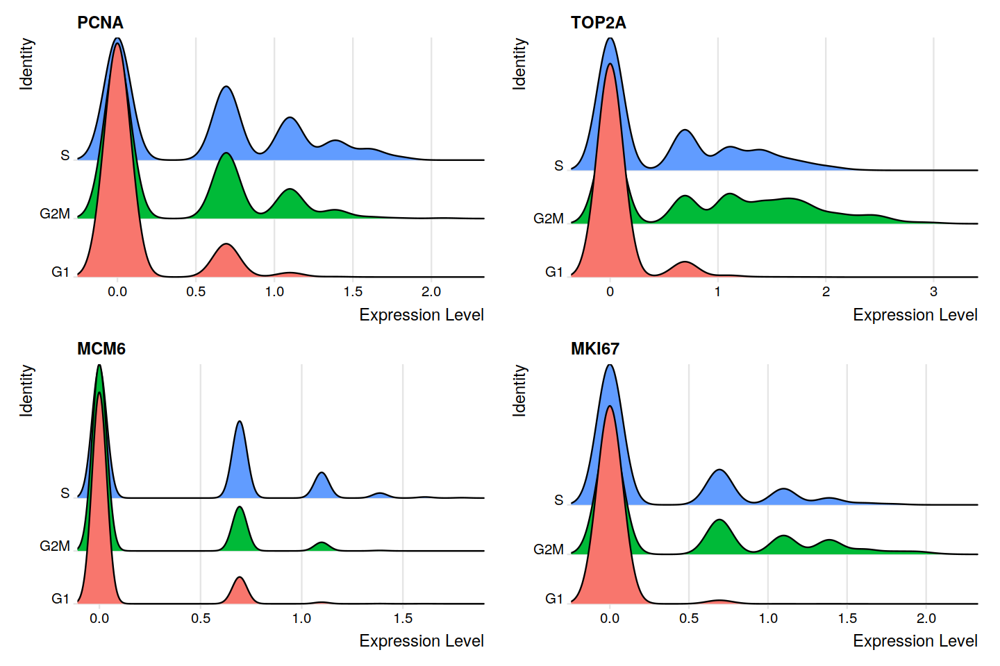

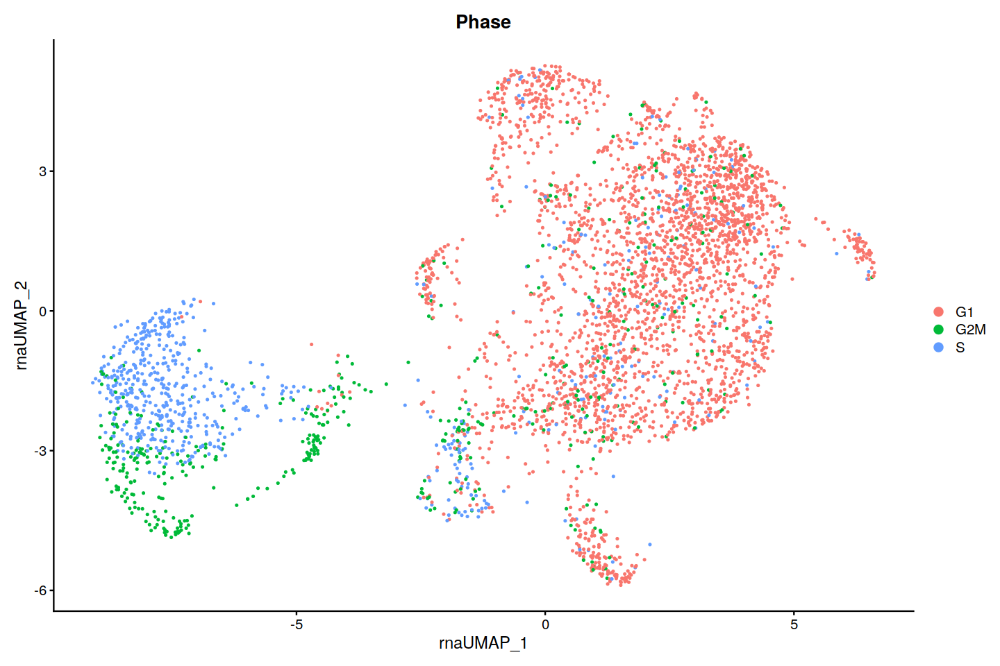

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


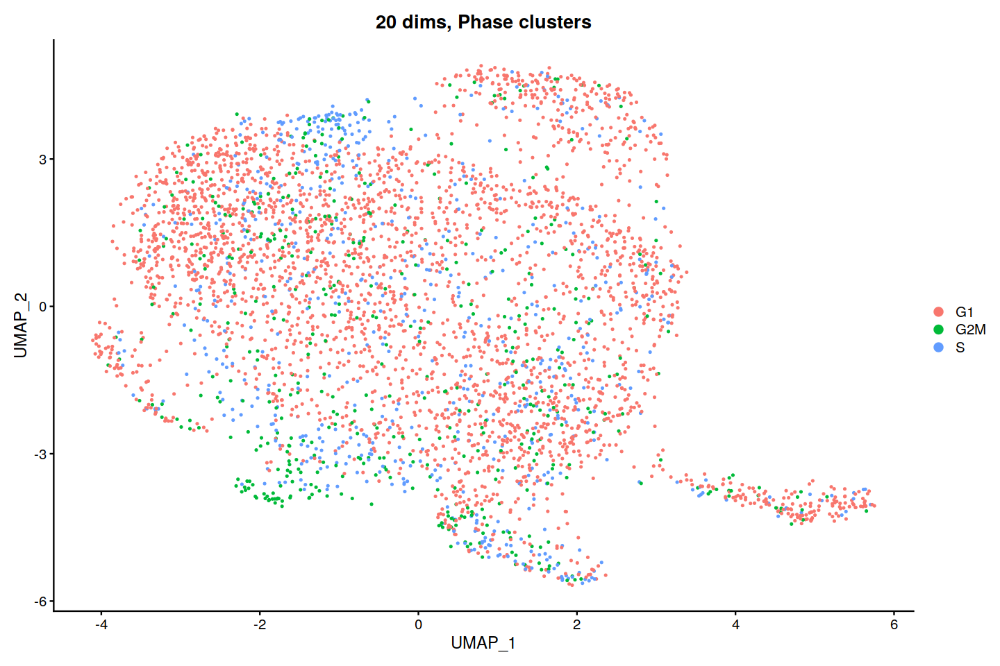

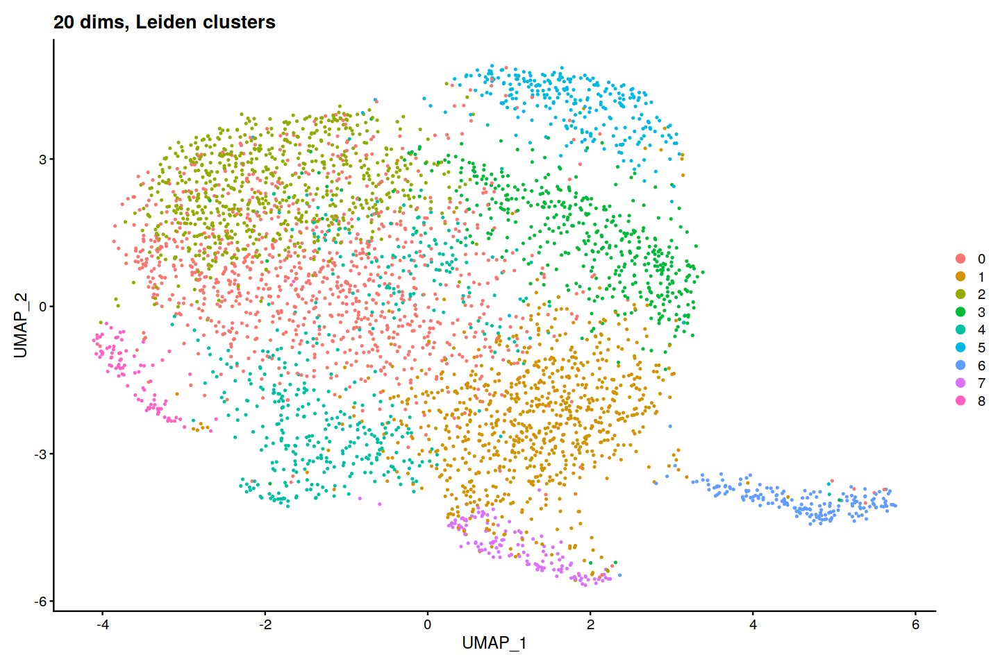

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


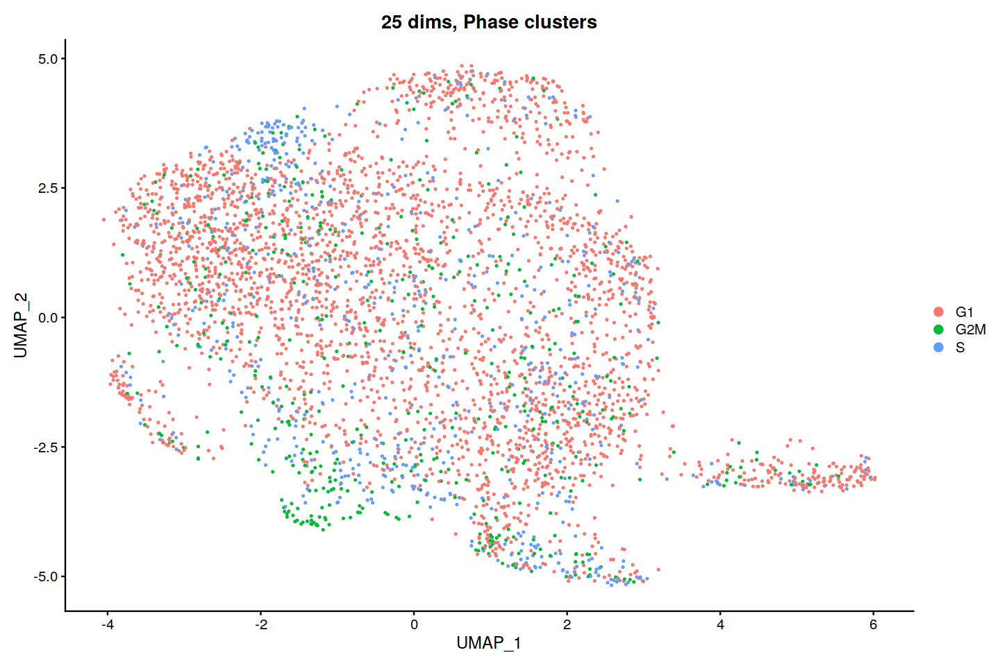

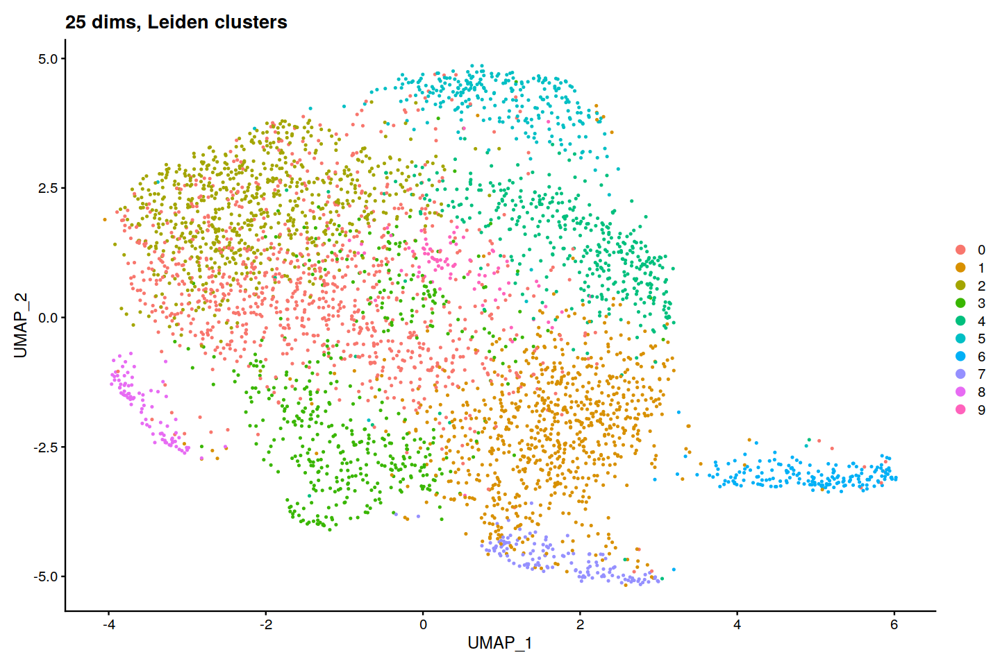

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


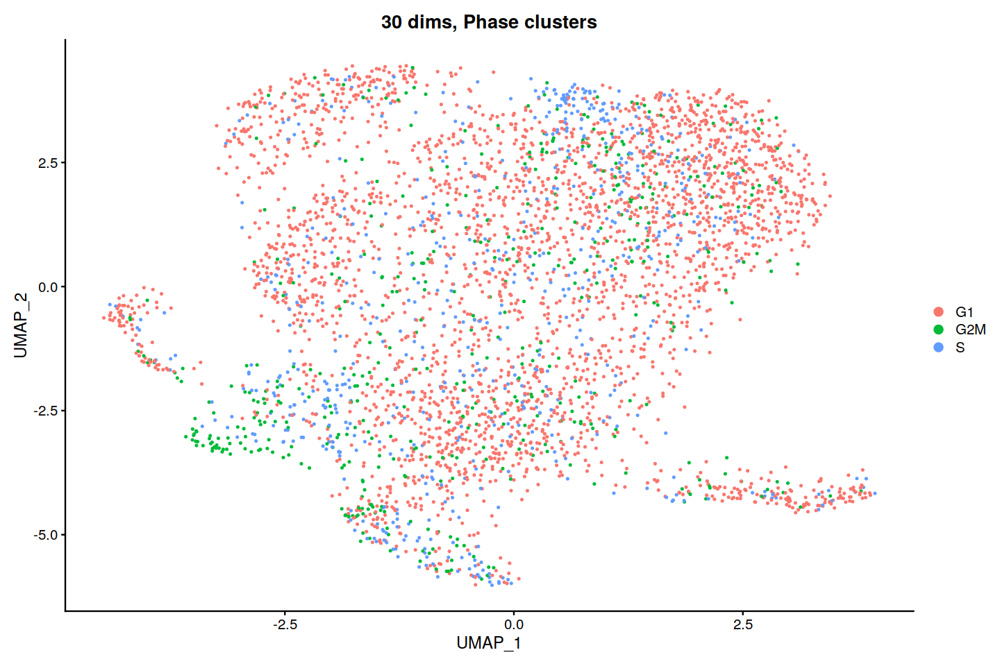

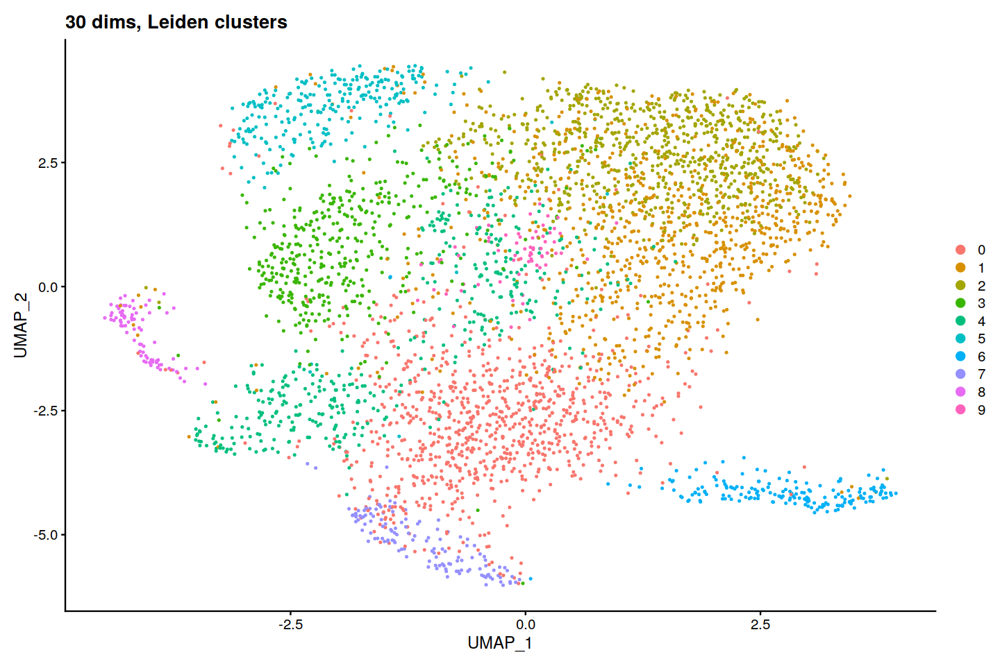

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


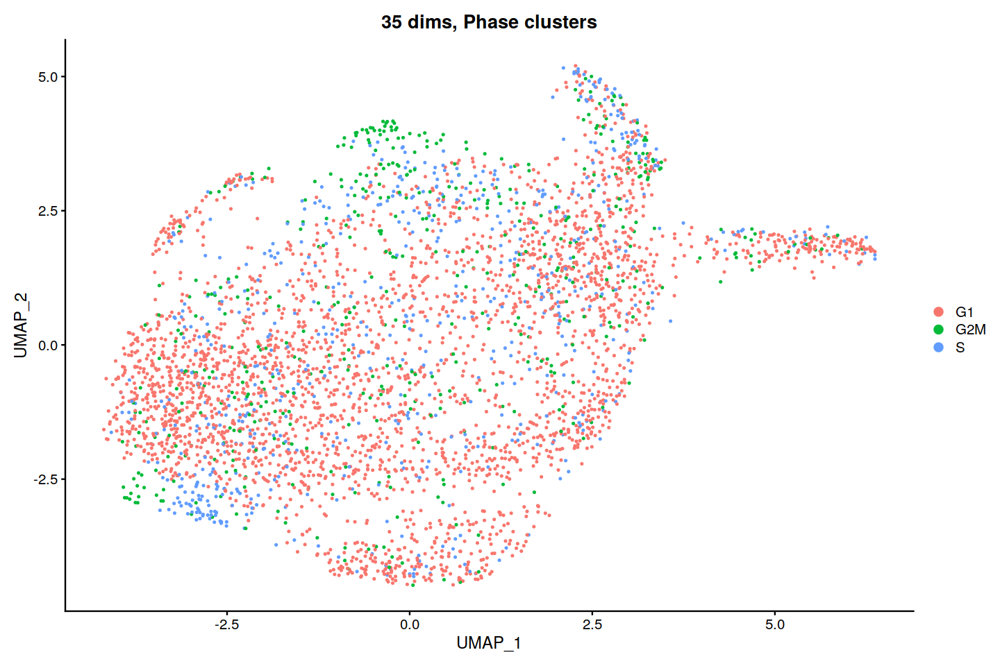

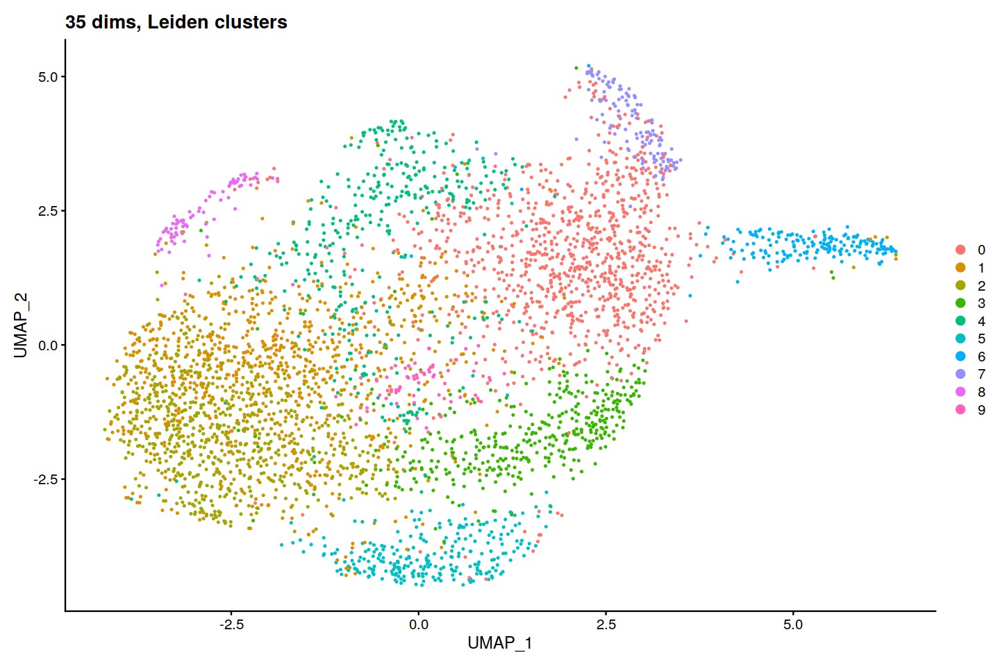

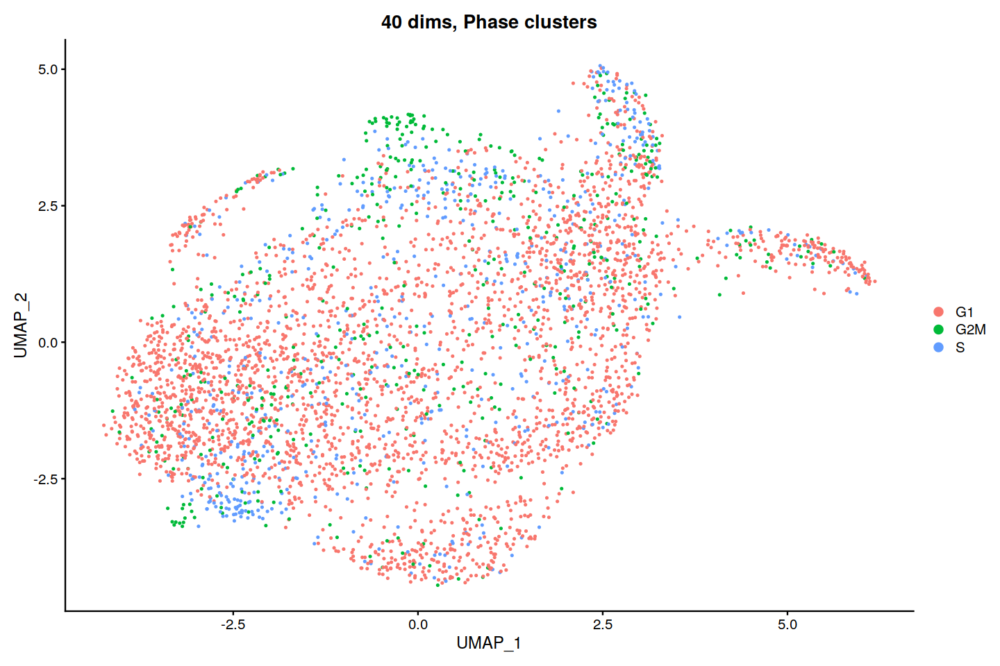

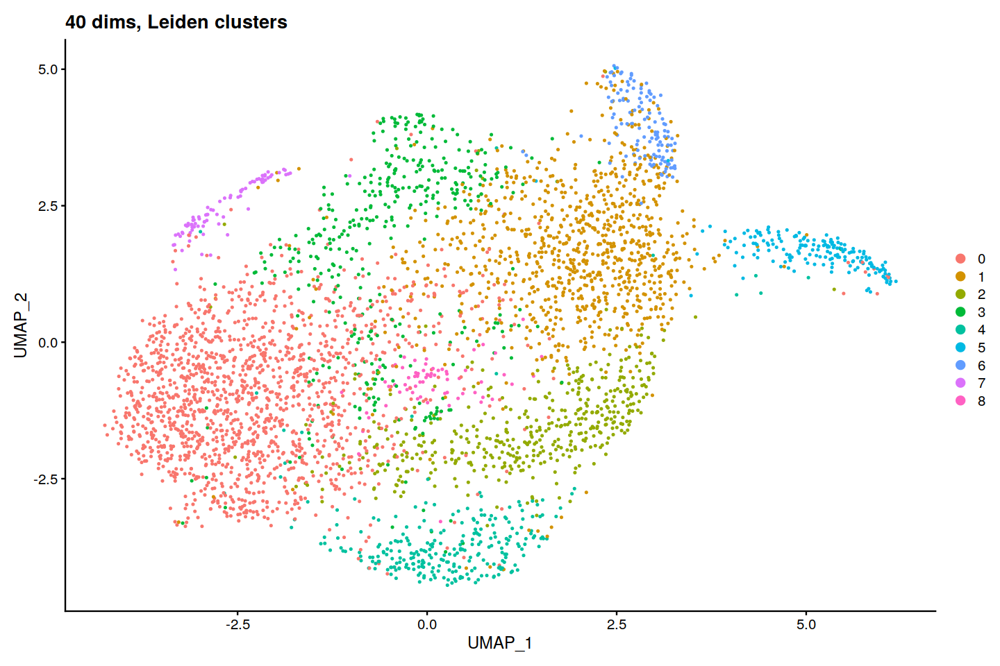

In [201]:
dasa1 <- regress_cell_cycle_genes(dasa1)

Warning message:
“The following features are not present in the object: MLF1IP, not searching for symbol synonyms”
Warning message:
“The following features are not present in the object: FAM64A, HN1, not searching for symbol synonyms”
Picking joint bandwidth of 0.04

Picking joint bandwidth of 0.119

Picking joint bandwidth of 0.0337

Picking joint bandwidth of 0.0776

Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 44 features requested have not been scaled (running reduction without them): MCM5, FEN1, MCM2, RRM1, UNG, GINS2, MCM6, PRIM1, UHRF1, MLF1IP, RFC2, RPA2, SLBP, CCNE2, UBR7, POLD3, MSH2, RAD51, CDC6, TIPIN, DSCC1, CASP8AP2, USP1, CHAF1B, E2F8, UBE2C, CKS2, FAM64A, CKAP2L, AURKB, HJURP, CDCA3, HN1, TTK, RANGAP1, NCAPD2, ECT2, PSRC1, LBR, CKAP5, CTCF, G2E3, GAS2L3, CENPA”
Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”
W

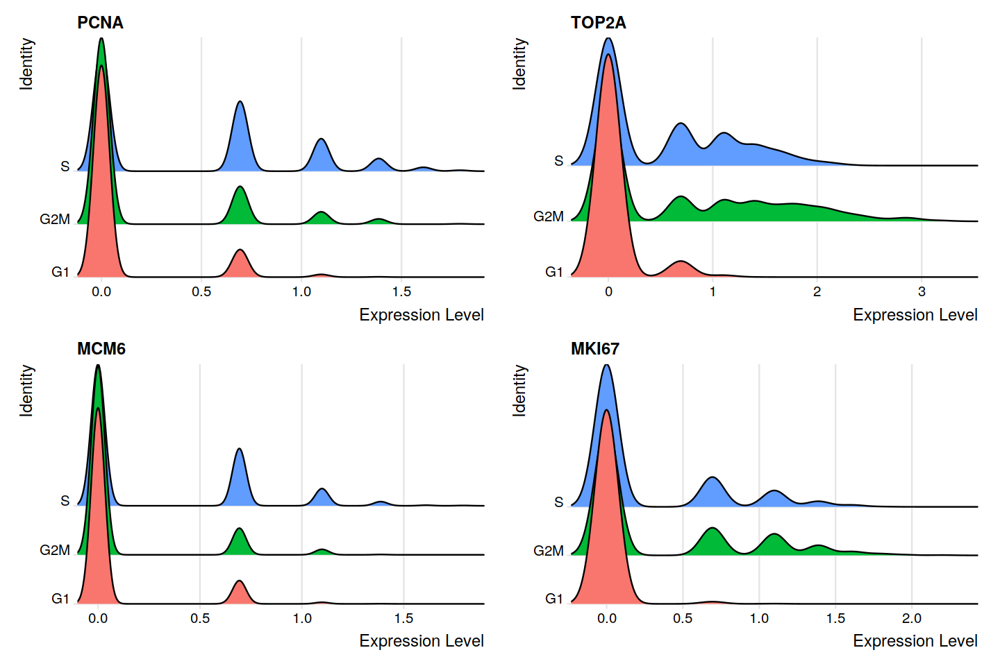

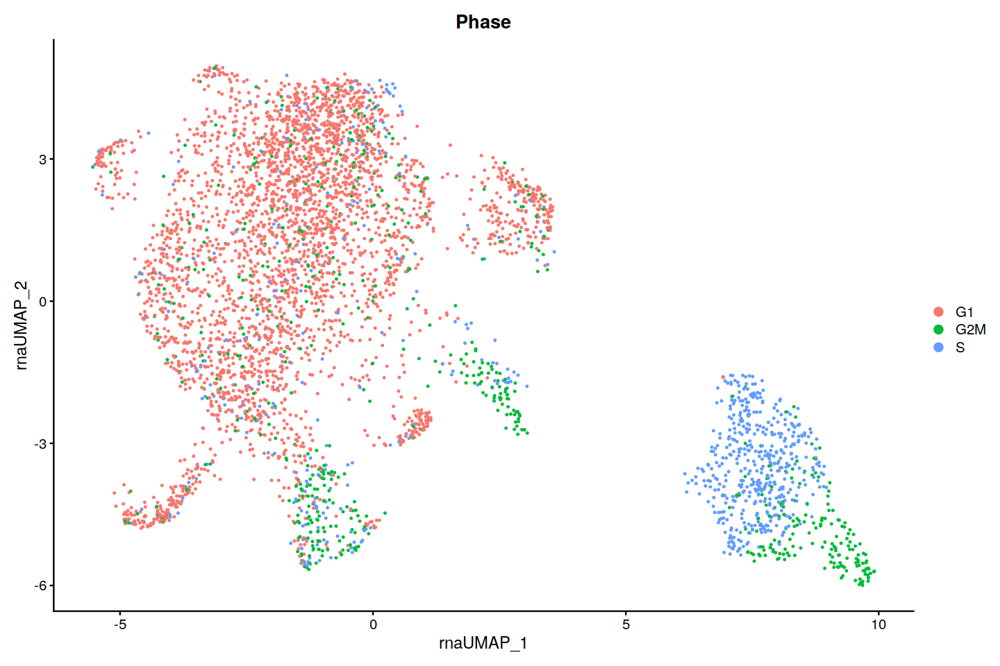

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


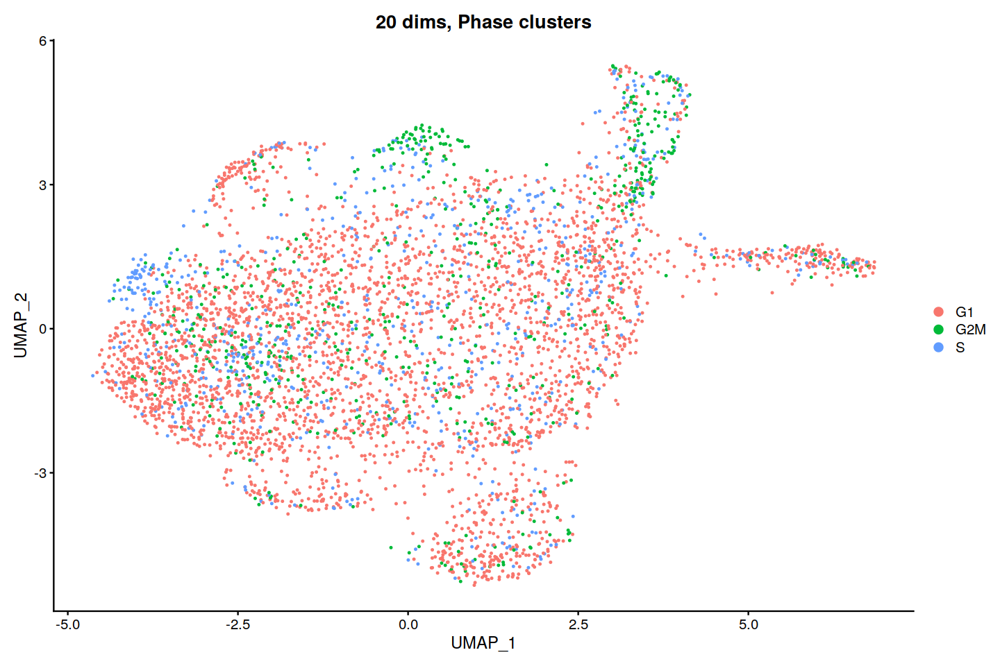

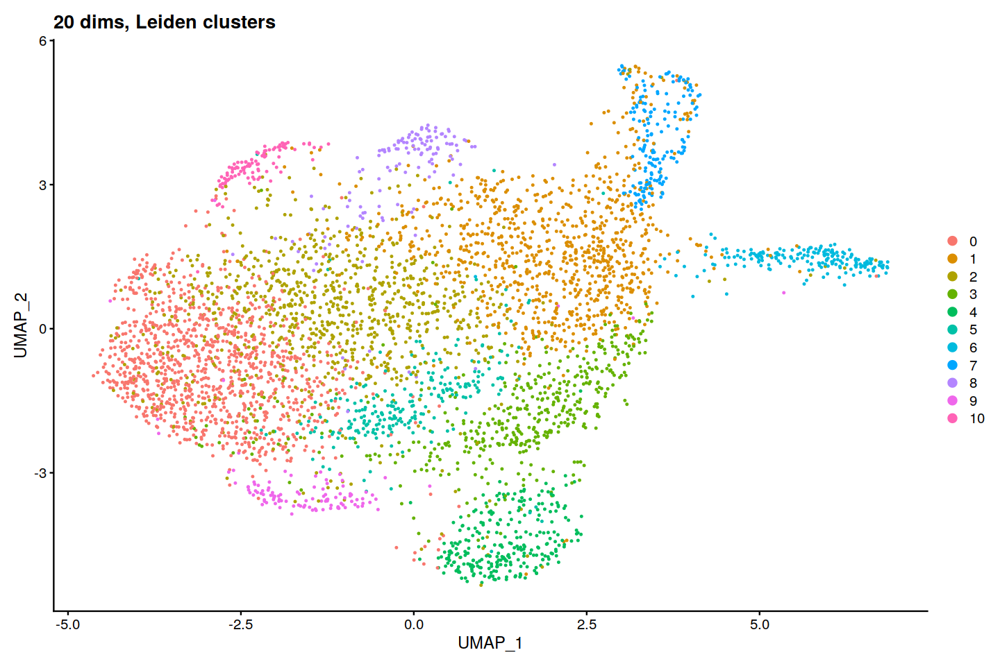

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


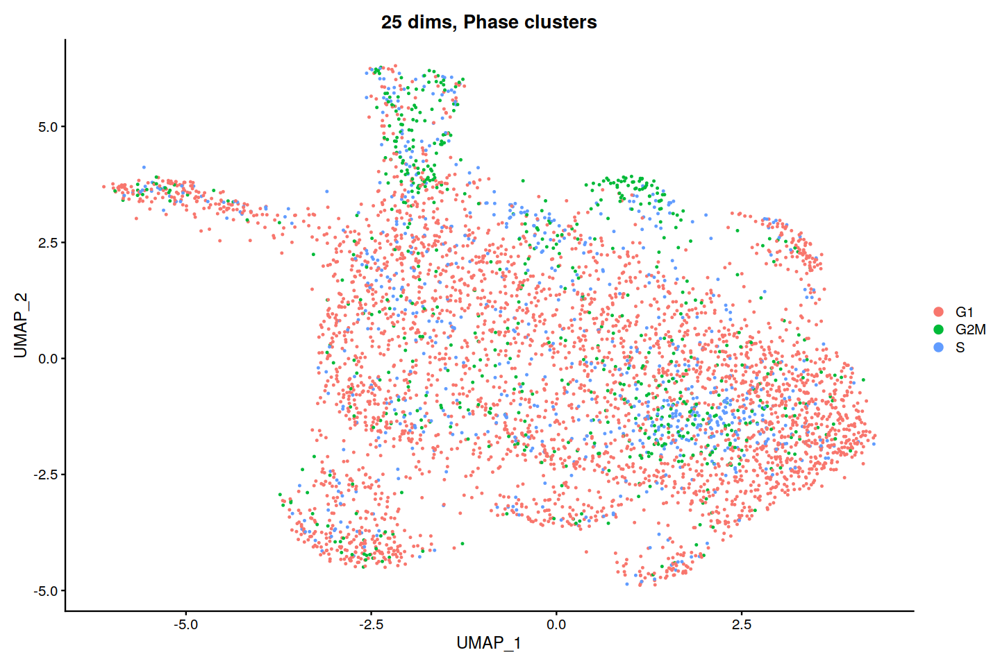

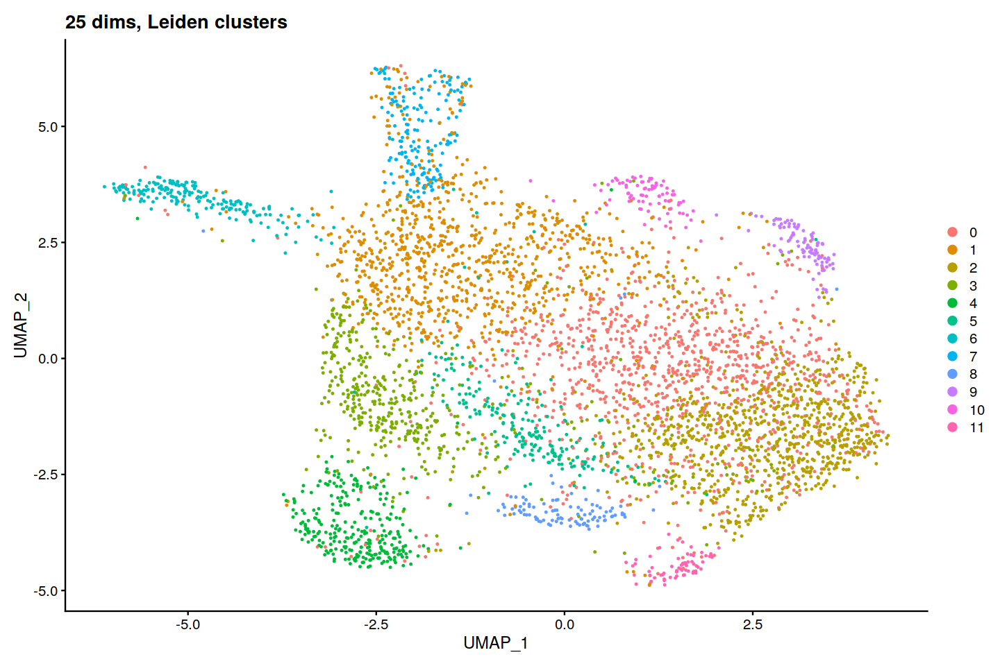

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


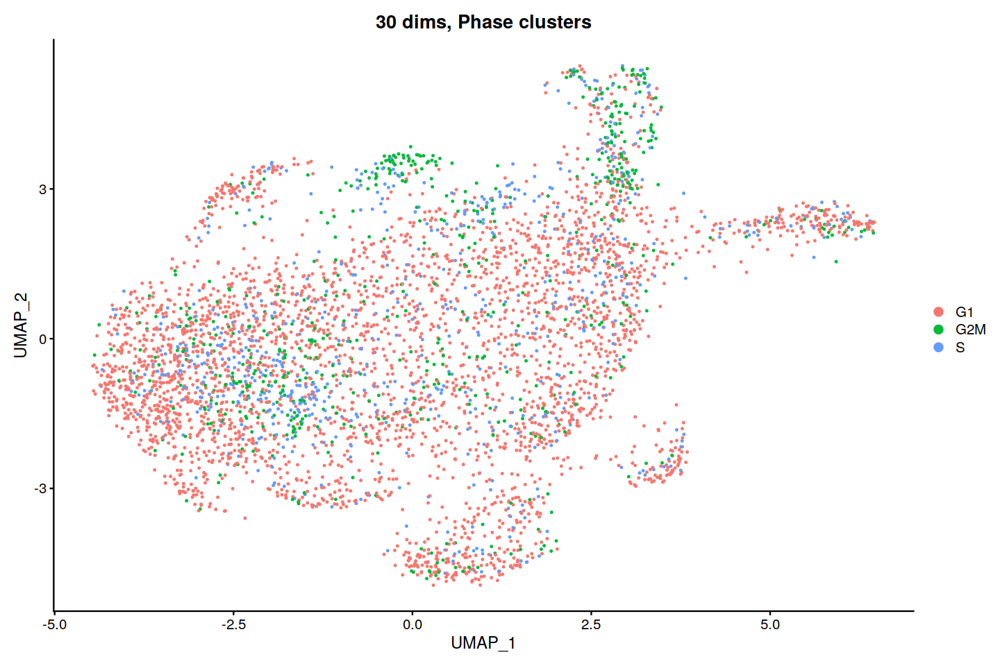

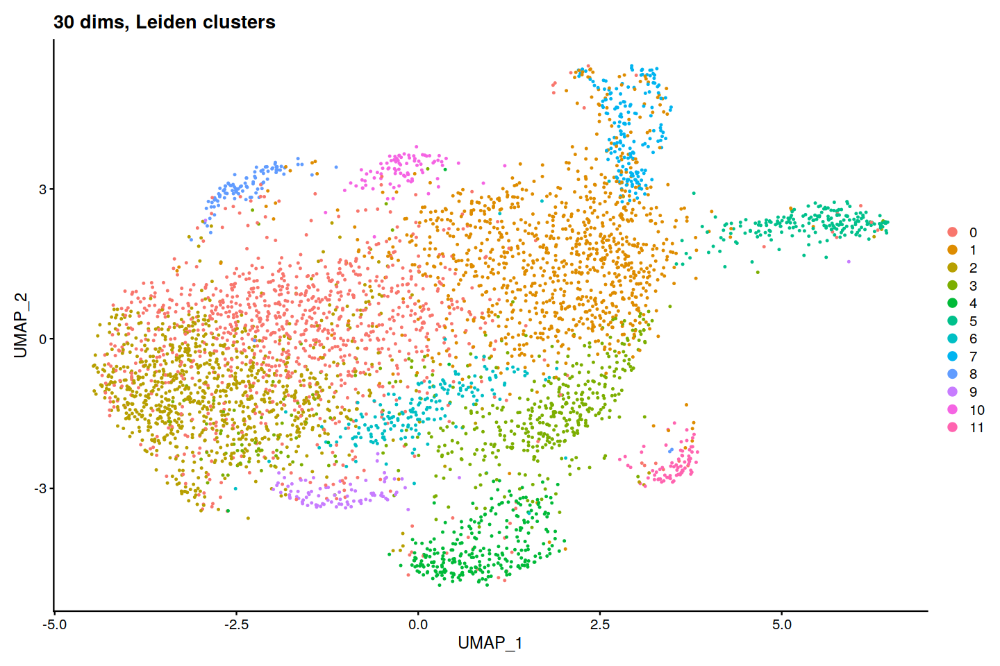

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


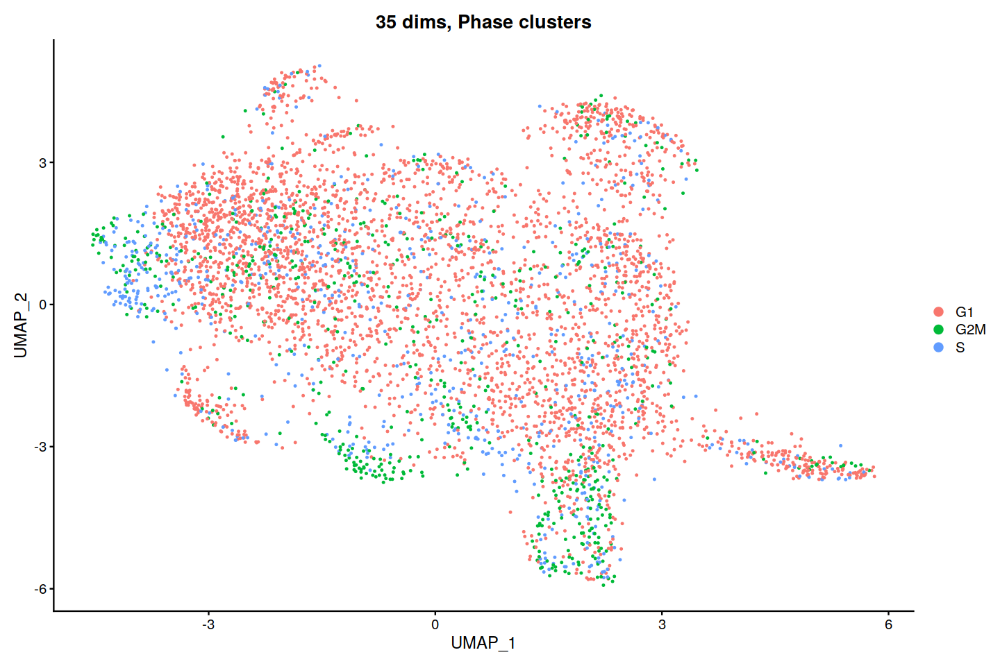

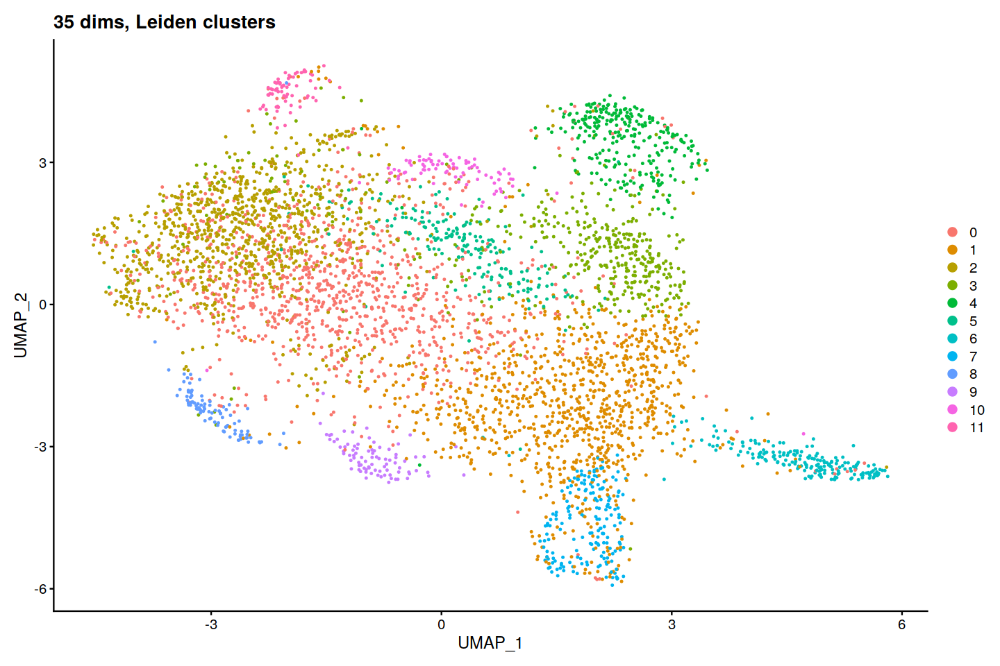

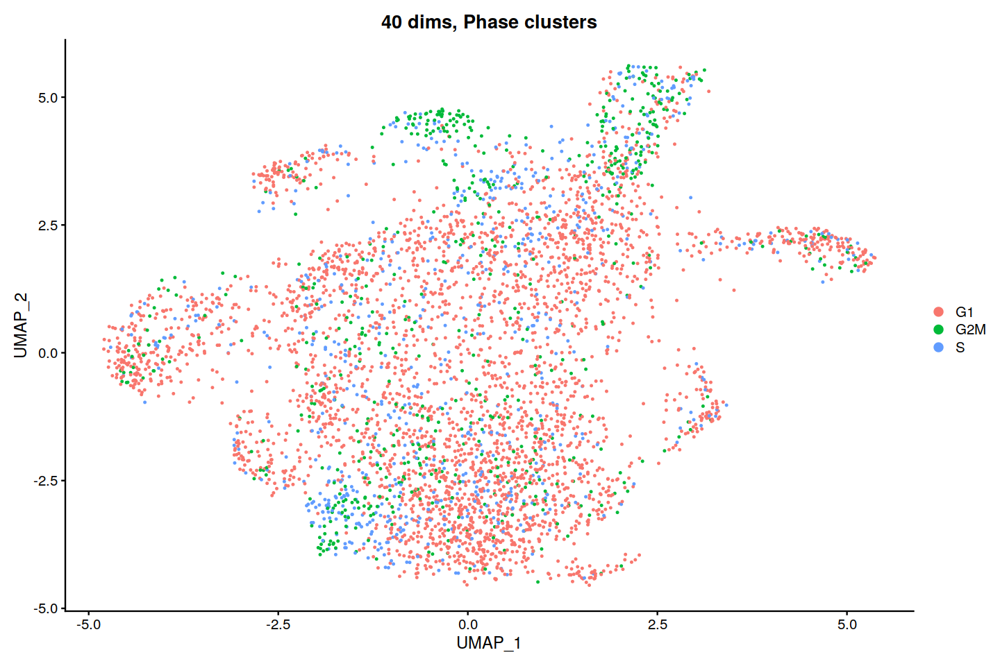

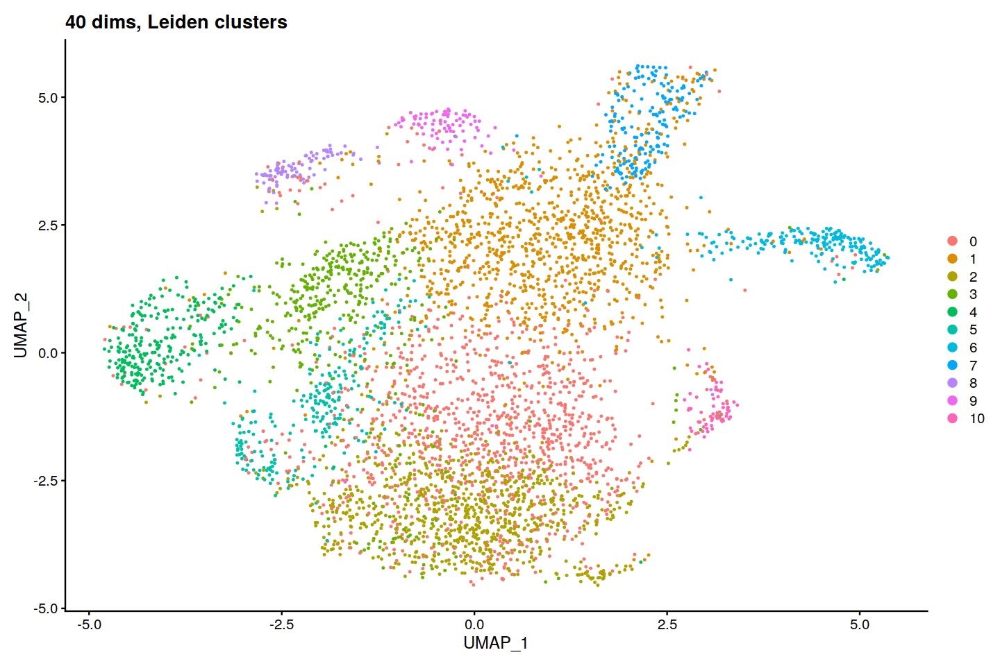

In [202]:
dasa2 <- regress_cell_cycle_genes(dasa2)

Warning message:
“The following features are not present in the object: MLF1IP, not searching for symbol synonyms”
Warning message:
“The following features are not present in the object: FAM64A, HN1, not searching for symbol synonyms”
Picking joint bandwidth of 0.0726

Picking joint bandwidth of 0.122

Picking joint bandwidth of 0.0639

Picking joint bandwidth of 0.0786

Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 45 features requested have not been scaled (running reduction without them): MCM5, PCNA, TYMS, FEN1, MCM2, MCM4, RRM1, UNG, GINS2, MCM6, PRIM1, UHRF1, MLF1IP, RFC2, RPA2, NASP, GMNN, WDR76, SLBP, CCNE2, UBR7, POLD3, MSH2, RAD51, CDC6, TIPIN, DSCC1, BLM, CASP8AP2, USP1, CHAF1B, E2F8, BIRC5, CKS1B, FAM64A, ANP32E, CDCA3, HN1, RANGAP1, NCAPD2, PSRC1, LBR, CTCF, NEK2, CBX5”
Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead

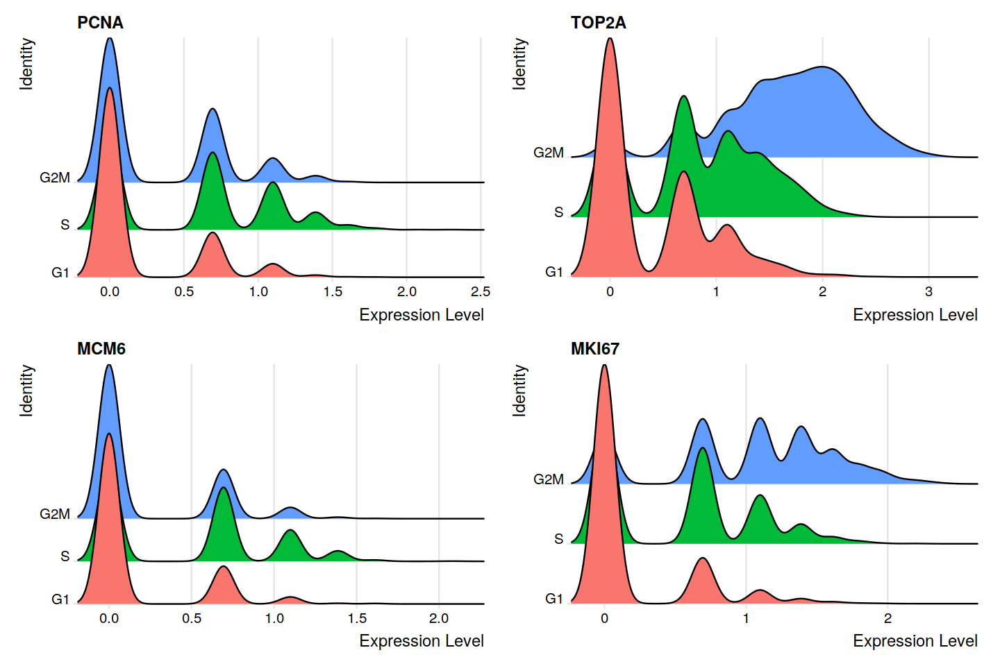

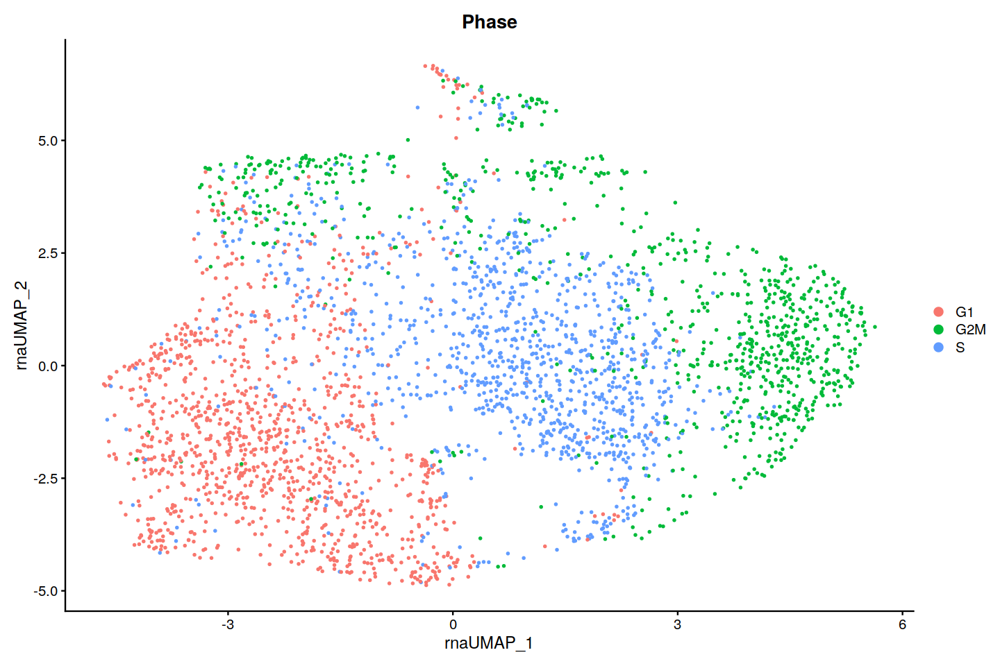

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


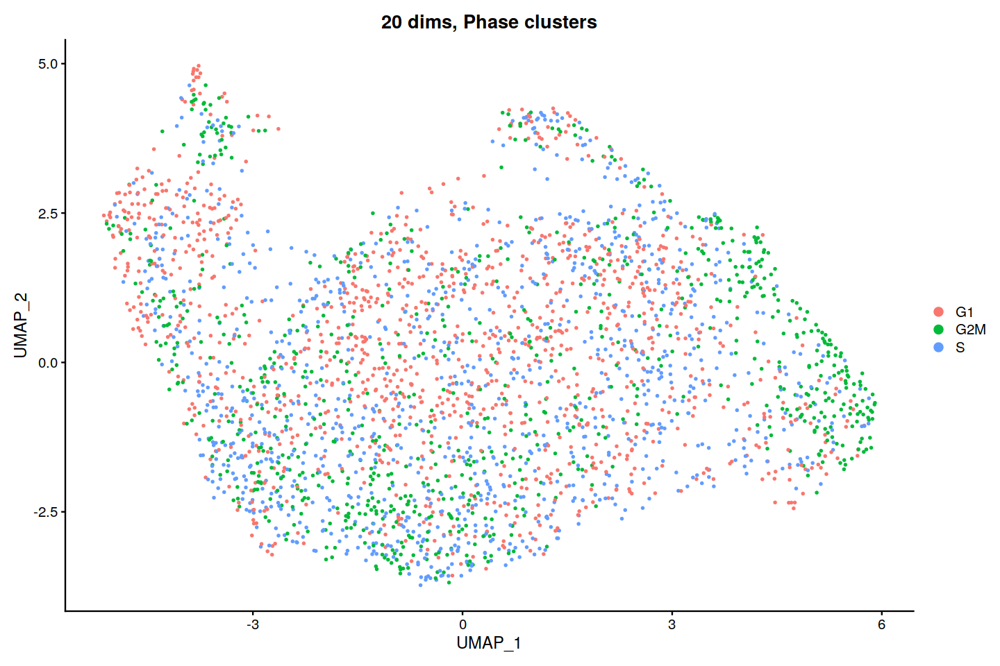

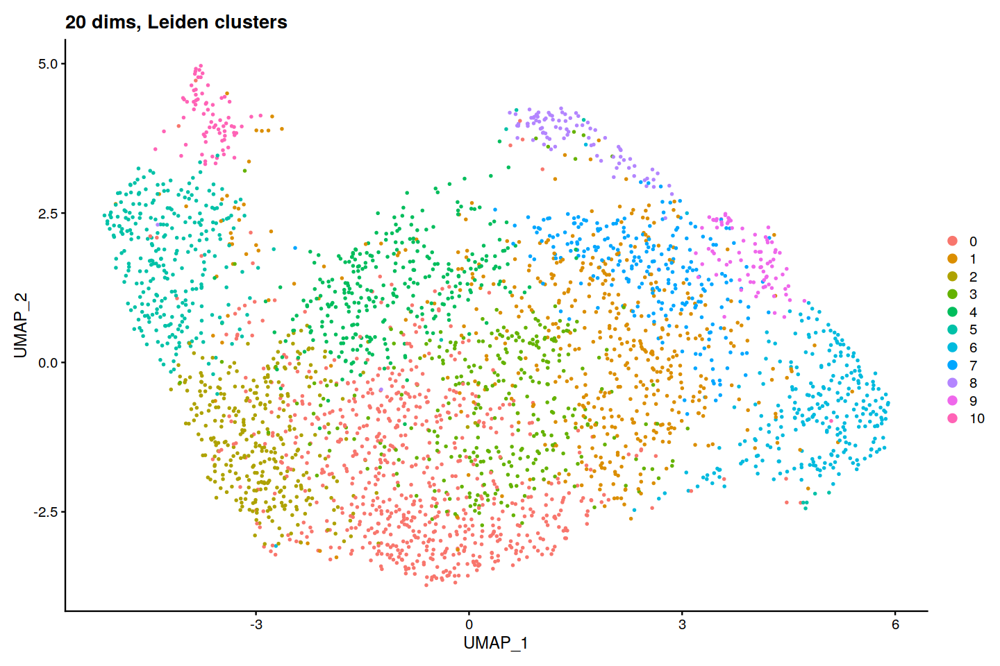

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


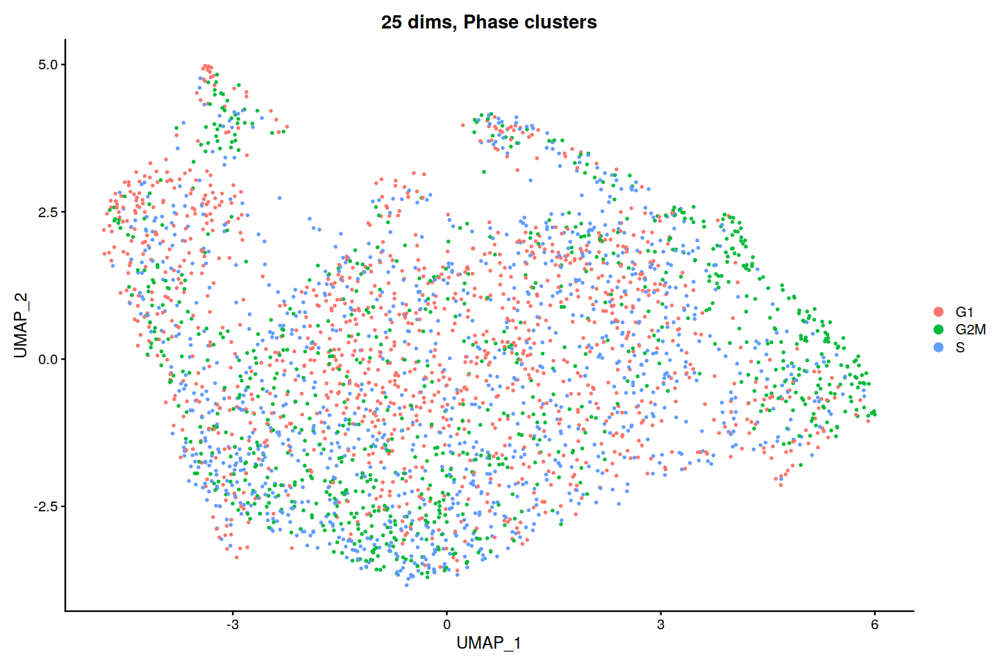

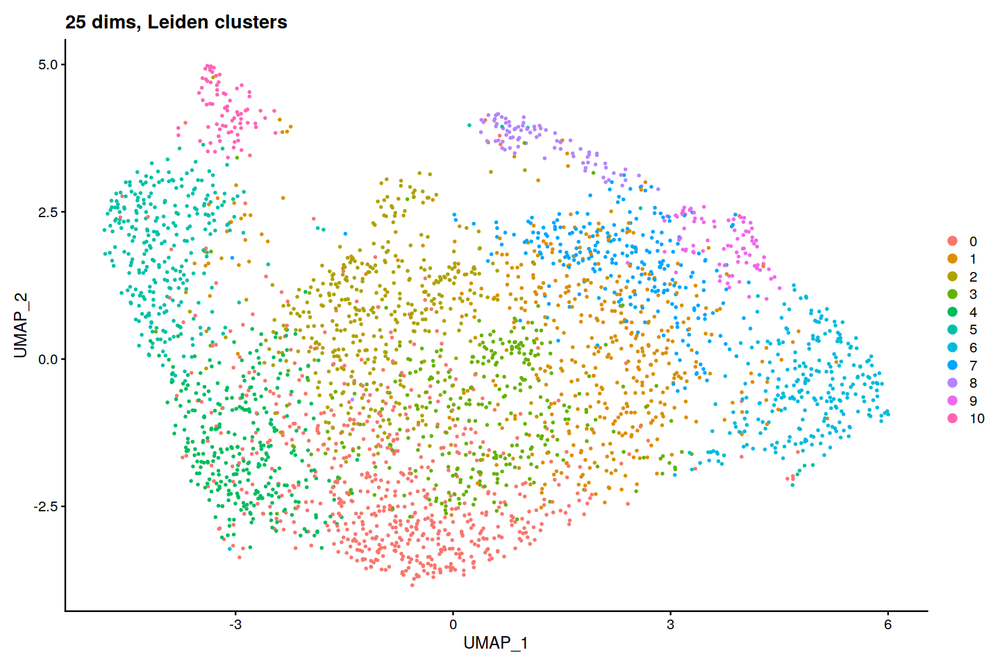

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


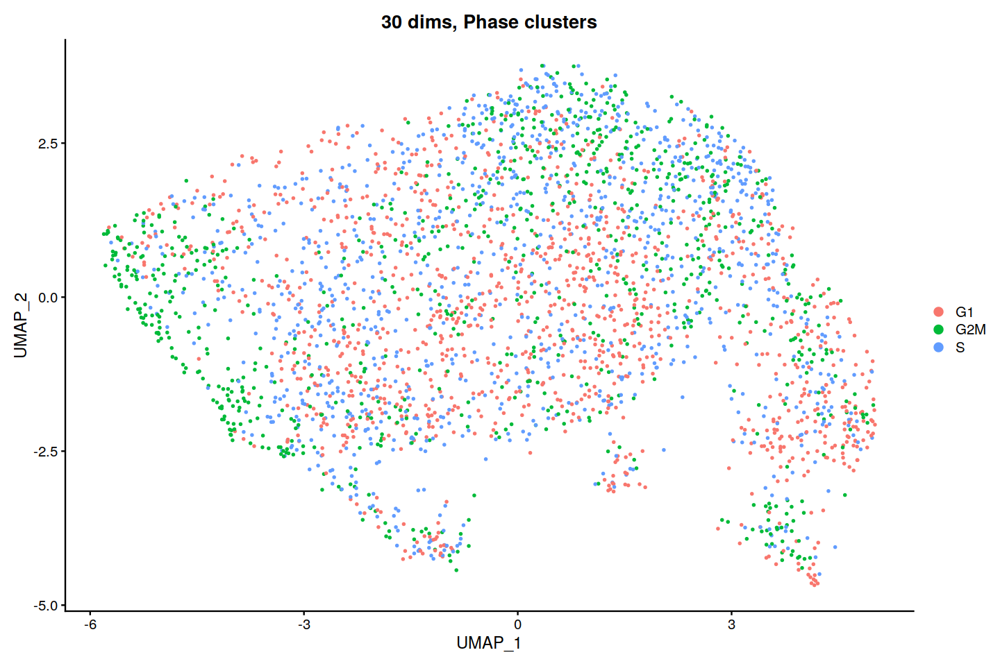

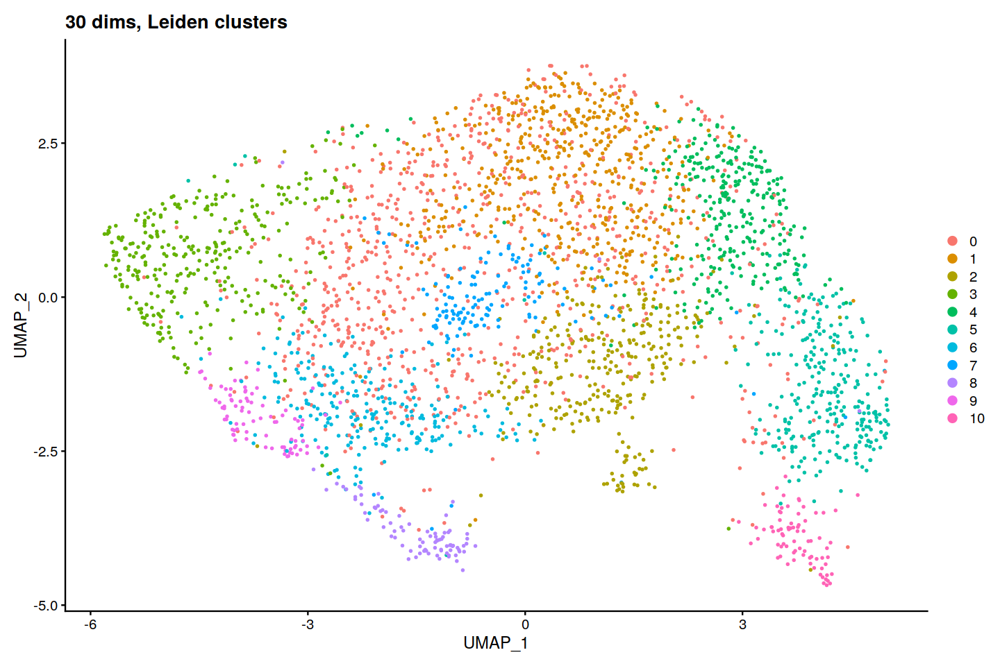

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


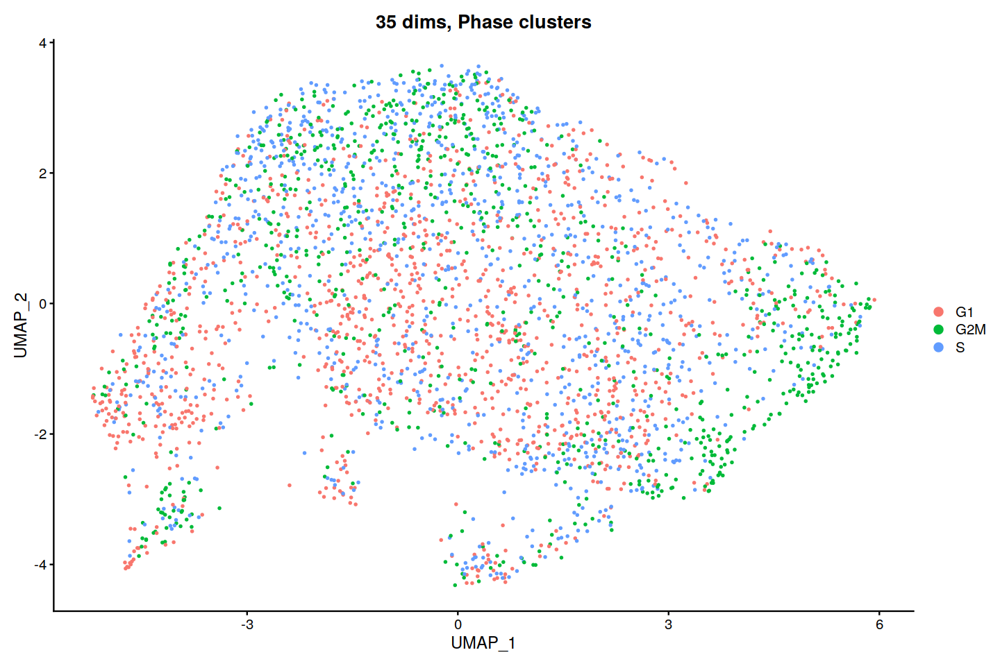

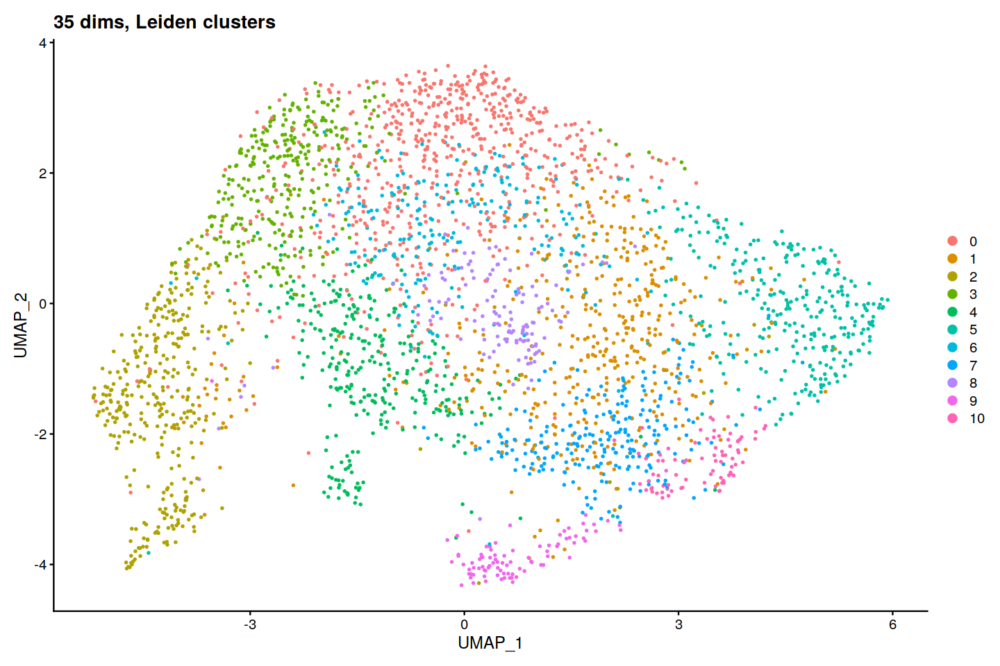

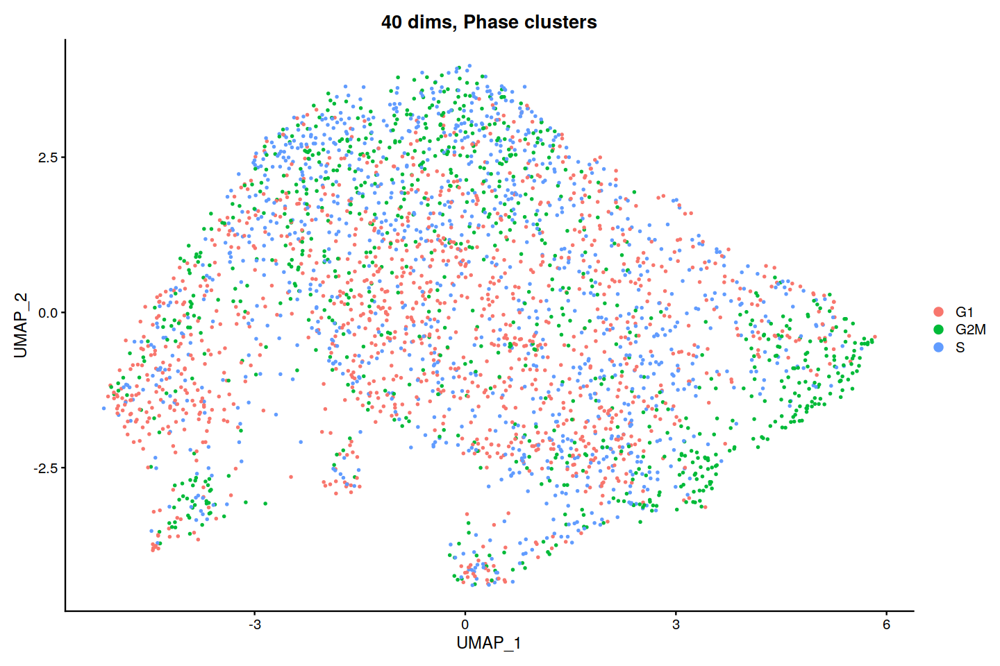

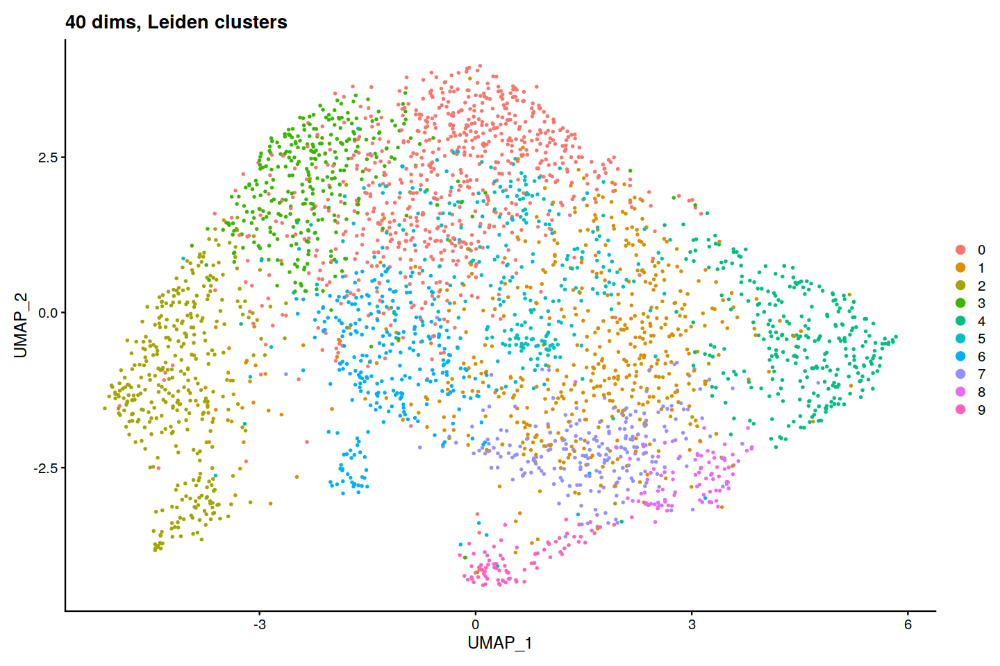

In [203]:
dmso1 <- regress_cell_cycle_genes(dmso1)

Warning message:
“The following features are not present in the object: MLF1IP, not searching for symbol synonyms”
Warning message:
“The following features are not present in the object: FAM64A, HN1, not searching for symbol synonyms”
Picking joint bandwidth of 0.0988

Picking joint bandwidth of 0.127

Picking joint bandwidth of 0.0922

Picking joint bandwidth of 0.115

Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 47 features requested have not been scaled (running reduction without them): PCNA, TYMS, FEN1, MCM2, MCM4, RRM1, UNG, GINS2, MCM6, CDCA7, PRIM1, UHRF1, MLF1IP, RFC2, RPA2, NASP, GMNN, SLBP, CCNE2, UBR7, POLD3, MSH2, RAD51, CDC6, TIPIN, DSCC1, BLM, CASP8AP2, USP1, CHAF1B, E2F8, BIRC5, CKS1B, TMPO, FAM64A, ANP32E, HJURP, CDCA3, HN1, RANGAP1, NCAPD2, PSRC1, LBR, CTCF, NEK2, GAS2L3, CBX5”
Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standa

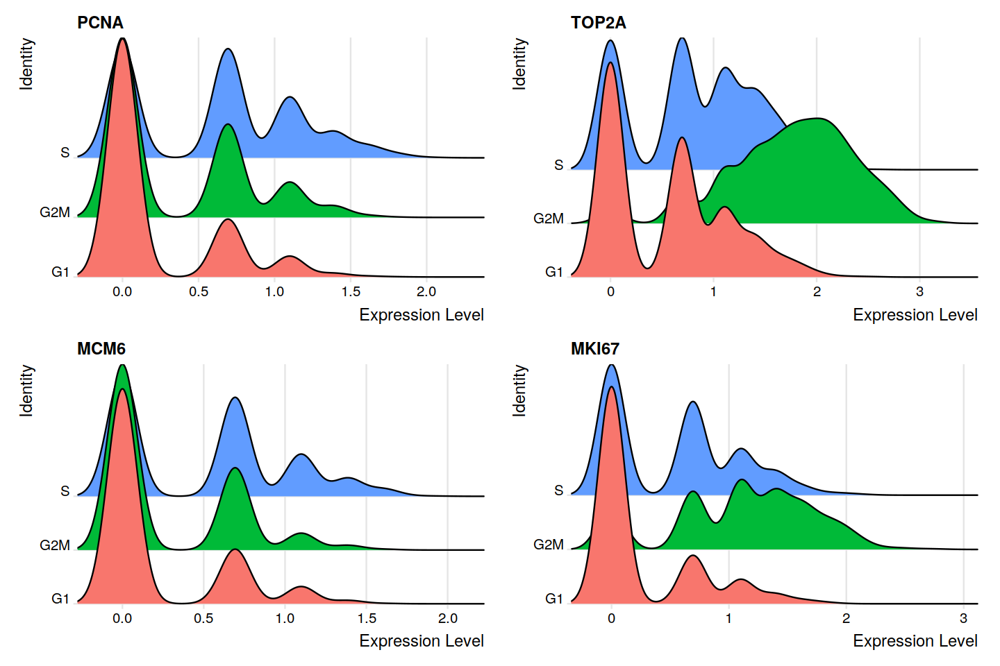

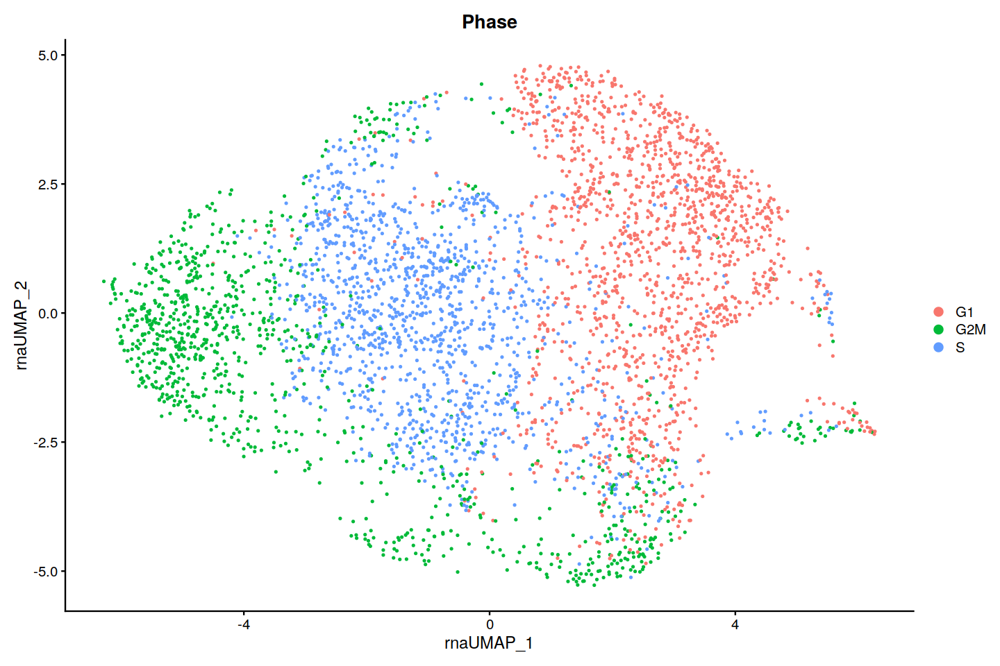

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


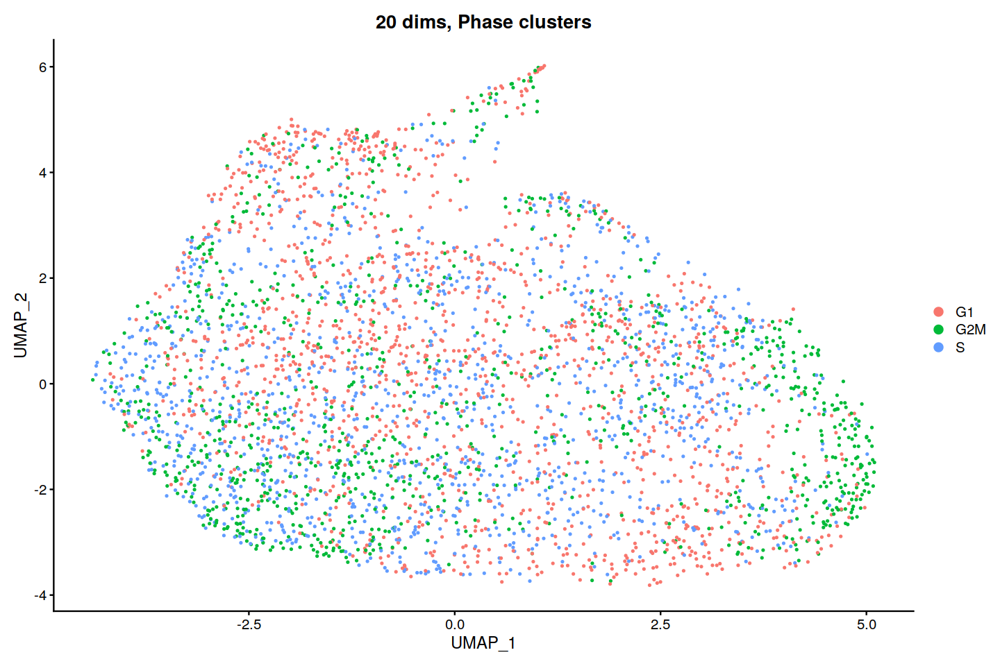

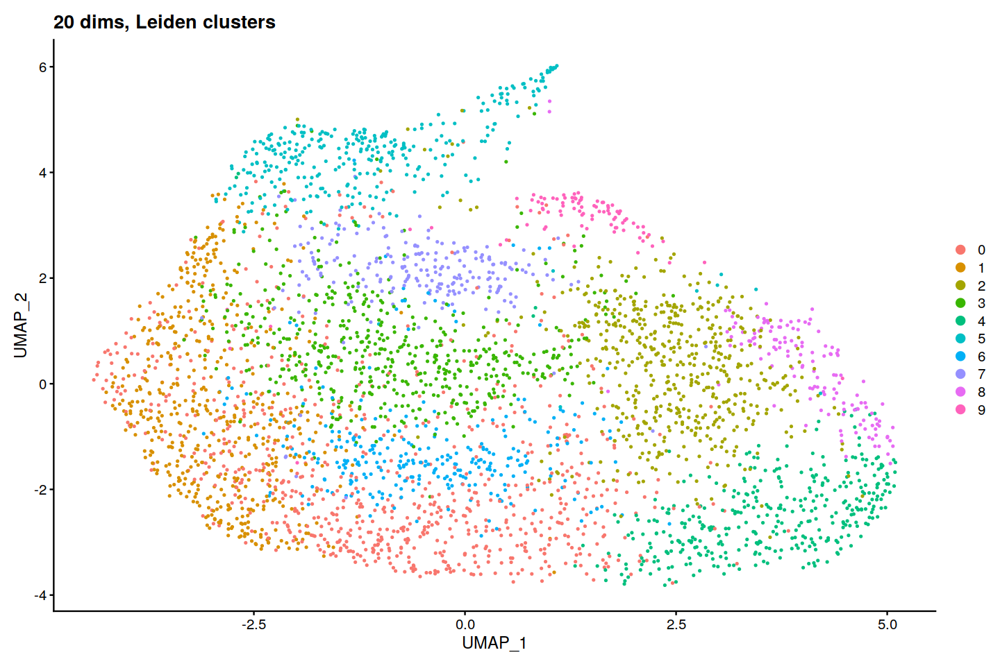

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


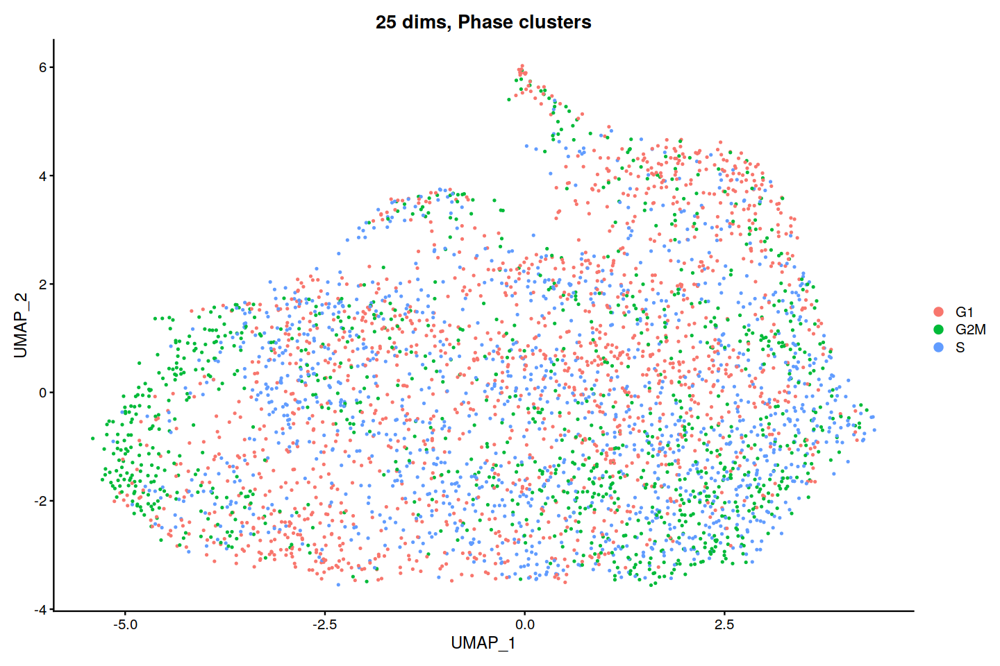

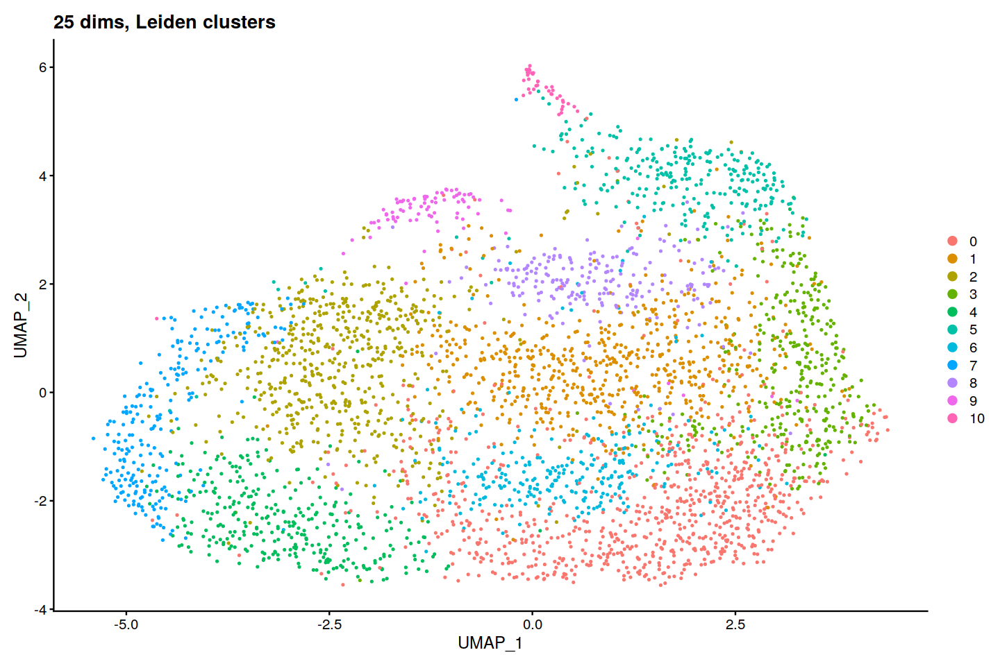

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


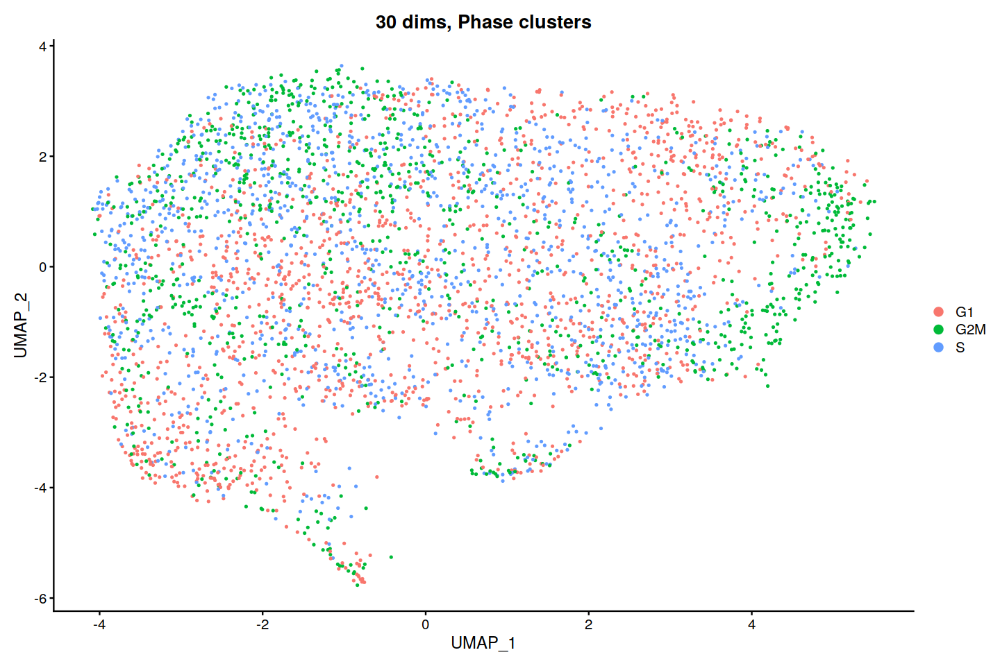

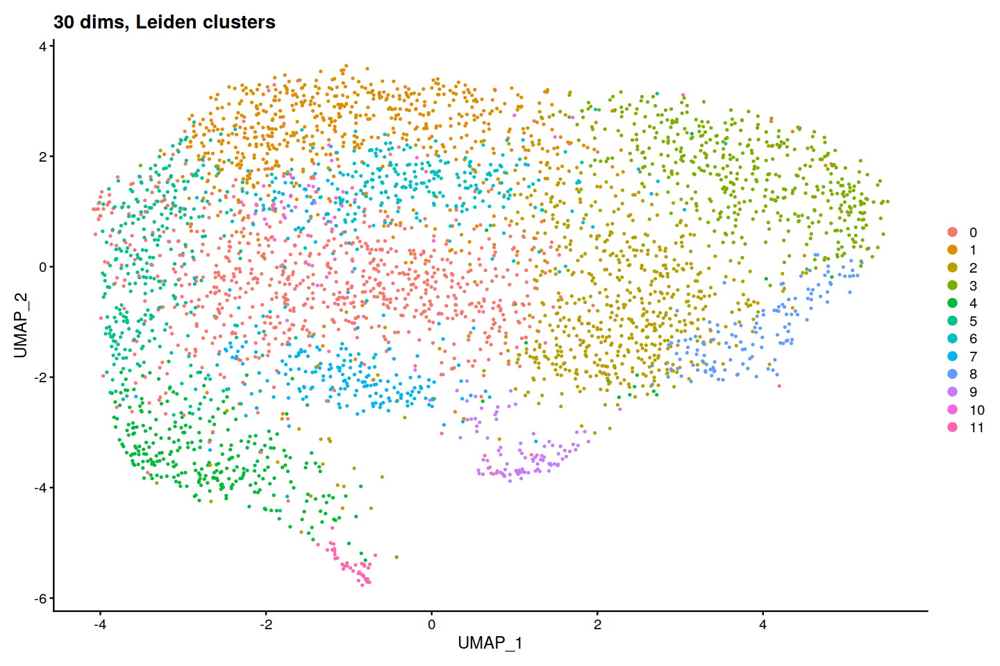

Warning message:
“The following arguments are not used: name”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”


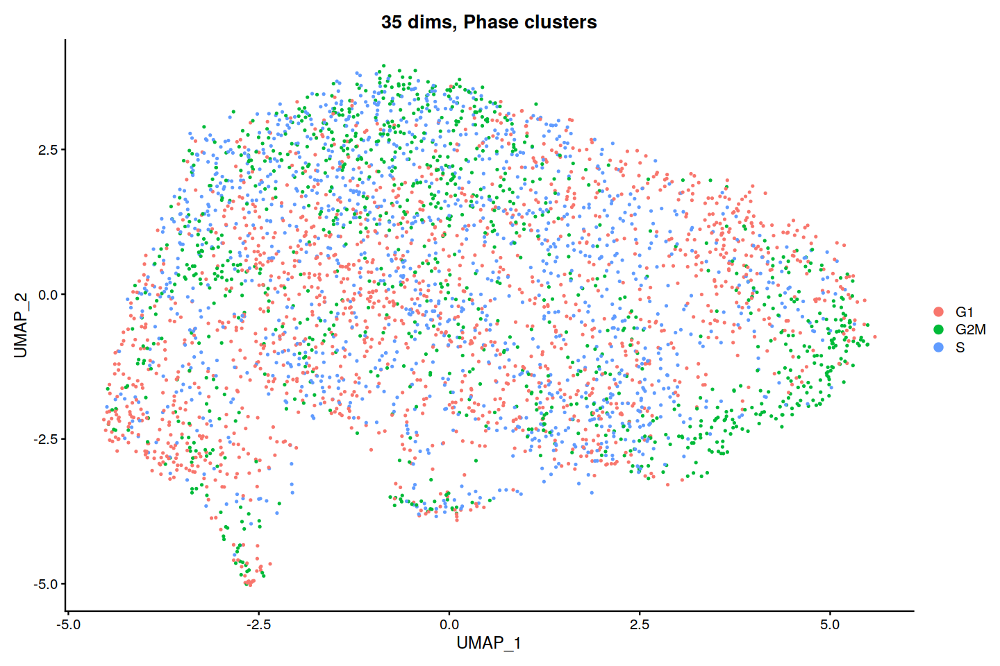

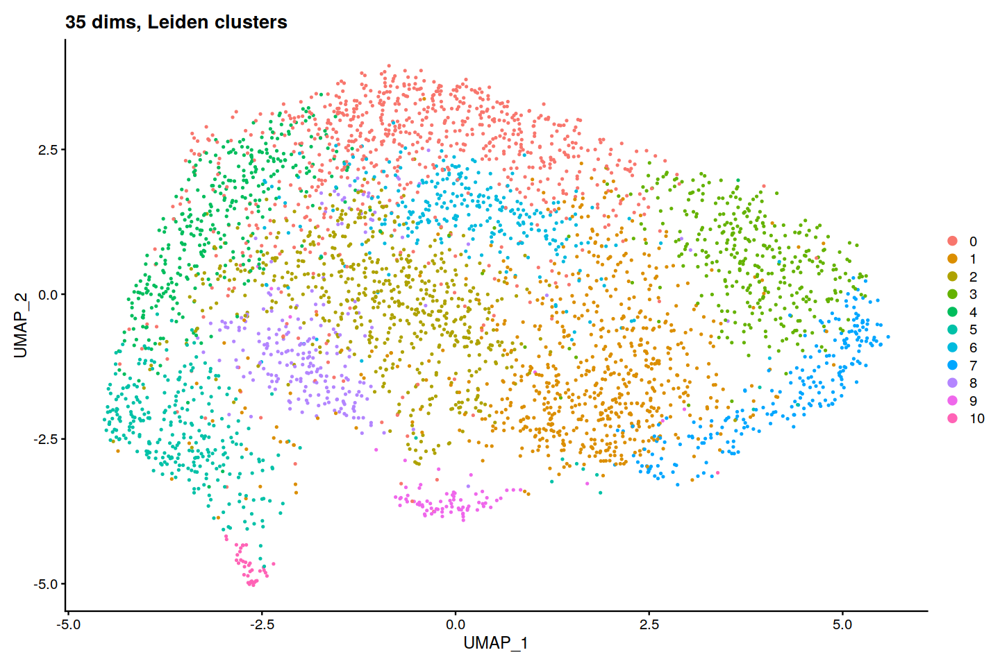

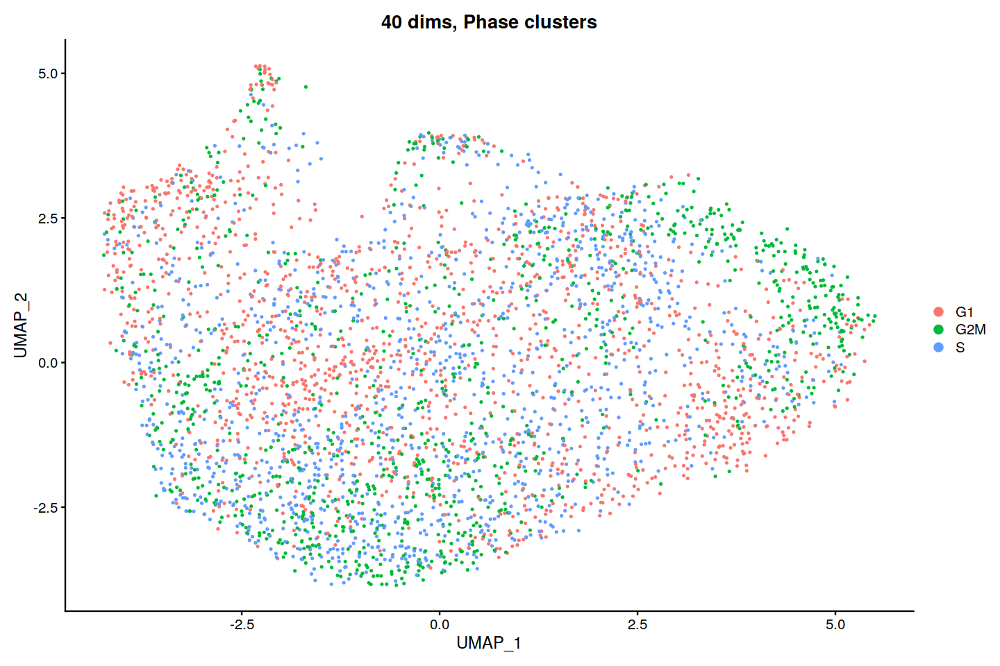

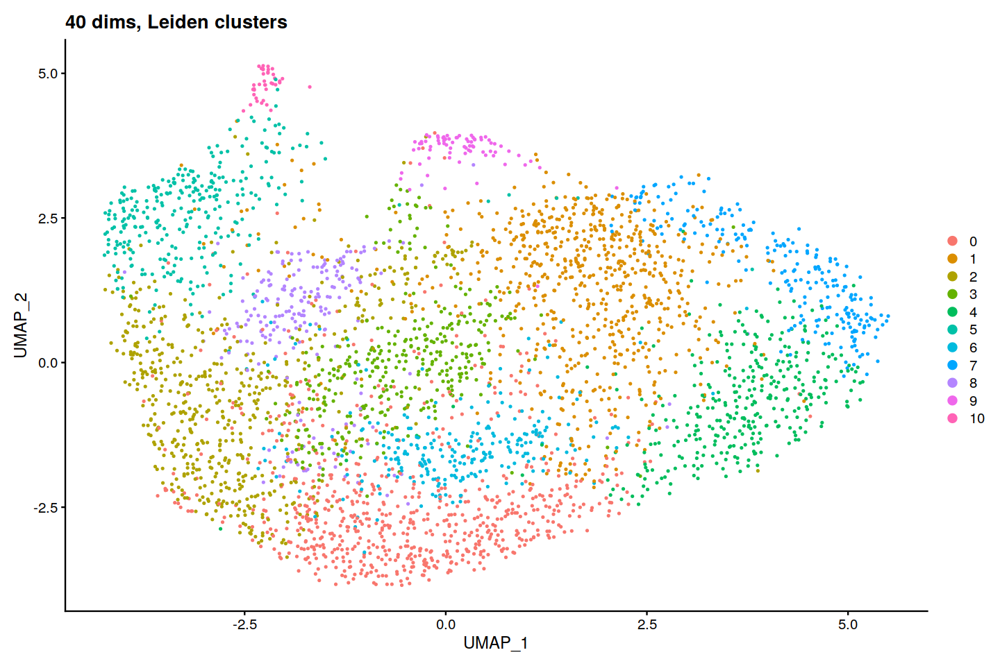

In [204]:
dmso2 <- regress_cell_cycle_genes(dmso2)

Based off the output of the 4 previous cells, we can now select the number of UMAP dims to use for each sample and proceed to run Mixscape

In [205]:
dasa1 <- umap_dim_test(dasa1, return_obj = TRUE, return_dim = 35)
dasa2 <- umap_dim_test(dasa2, return_obj = TRUE, return_dim = 30)
dmso1 <- umap_dim_test(dmso1, return_obj = TRUE, return_dim = 30)
dmso2 <- umap_dim_test(dmso2, return_obj = TRUE, return_dim = 30)

Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "igno

In [206]:
plan("multicore", workers = 64)
set.seed(1234)
options(digits=2)
stats <- c()
options(future.globals.maxSize= 568435456000) 

In [207]:
### run mixscape and make plots
run_mixscape <- function(sobj, plot_perturb_score=TRUE){
    # label perturb vs non-perturb
    sobj$Perturbation <- ifelse(grepl("^NT", sobj$guidecapture_classification), "NT", "Perturbed")
    sobj$isNT <- grepl("^NT", sobj$guidecapture_classification)
    # compare NT vs Perturbed
    p1 <- DimPlot(
      object = sobj, 
      group.by = 'Perturbation', 
      pt.size = 0.5, 
      reduction = "umap", 
      split.by = "Perturbation", 
      ncol = 1, 
      cols = c("grey39","goldenrod3")) + 
      ggtitle("Perturbation Status") +
      ylab("UMAP 2") +
      xlab("UMAP 1") +
      custom_theme
    print(p1)
    # assign NT to all guides that started with NT
    sobj$guidecapture_classification[sobj$isNT] <- "NT"
    sobj$guidecapture_classification
    
    sobj <- CalcPerturbSig(
      object = sobj, 
      assay = "SCT", 
      slot = "data", 
      gd.class ="guidecapture_classification", 
      nt.cell.class = "NT", 
      reduction = "pca", 
      ndims = 30, 
      num.neighbors = 20, 
      new.assay.name = "PRTB")
    
    # Prepare PRTB assay for dimensionality reduction: 
    # Normalize data, find variable features and center data.
    DefaultAssay(object = sobj) <- 'PRTB'
    # Use variable features from RNA assay.
    VariableFeatures(object = sobj) <- VariableFeatures(object = sobj[["SCT"]])
    sobj <- ScaleData(object = sobj, do.scale = F, do.center = T)
    DefaultAssay(sobj) <- "SCT"
    
    # Run PCA to reduce the dimensionality of the data.
    sobj <- RunPCA(object = sobj, reduction.key = 'prtbpca', reduction.name = 'prtbpca')
    
    options(repr.plot.width = 10, repr.plot.height = 7)
    # Run UMAP to visualize clustering in 2-D.
    sobj <- RunUMAP(
      object = sobj, 
      dims = 1:30, 
      reduction = 'prtbpca', 
      reduction.key = 'prtbumap', 
      reduction.name = 'prtbumap')

    q1 <- DimPlot(
      object = sobj, 
      group.by = 'Phase', 
      reduction = 'prtbumap', 
      pt.size = 0.2, label = F, repel = T) +
      ggtitle("Cell Cycle Phase") +
      ylab("UMAP 2") +
      xlab("UMAP 1") + 
      custom_theme

    q2 <- DimPlot(
      object = sobj,
      group.by = 'Perturbation',
      reduction = 'prtbumap', 
      split.by = "Perturbation", 
      ncol = 1, 
      pt.size = 0.2, 
      cols = c("grey39","goldenrod3")) +
      ggtitle("Perturbation Status") +
      ylab("UMAP 2") +
      xlab("UMAP 1") +
      custom_theme

    # Visualize plots.
    print(q1 + plot_layout(guides = 'auto') | q2)
    
    p2 <- DimPlot(
      object = sobj,
      group.by = 'guidecapture_classification',
      reduction = 'prtbumap', 
      ncol = 1, 
      pt.size = 1.5,
      label = TRUE)
    print(p2)
    
    # Run mixscape.
    sobj <- RunMixscape(
      object = sobj, 
      assay = "PRTB", 
      slot = "scale.data", 
      labels = "guidecapture_classification", 
      nt.class.name = "NT", 
      new.class.name = "mixscape_class",
      min.de.genes = 2,                
      iter.num = 10, 
      de.assay = "SCT",
      logfc.threshold = 0.25,
      verbose = F,
      prtb.type = "KD")
    
    # Calculate percentage of KO cells for all target gene classes.
    df1 <- prop.table(table(sobj$mixscape_class.global, sobj$guidecapture_classification),2)

    df2 <- reshape2::melt(df1)
    df2

    options(repr.plot.width = 30, repr.plot.height = 10)
    print(ggplot(df2, aes(x = Var2, y = value*100, fill= Var1)) +
      geom_bar(stat= "identity") +
      theme_classic()+
      scale_fill_manual(values = c("coral1","grey79", "grey49")) + 
      ylab("% of cells") +
      xlab("sgRNA") + theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1), 
                            text = element_text(size = 18))) 
    
    # Run DE analysis and visualize results on a heatmap ordering cells by their posterior 
    # probability values.
    # HIC2-1
    Idents(object = sobj) <- "guidecapture_classification"
    print(MixscapeHeatmap(object = sobj, 
                    logfc.threshold = 0.2,
                    ident.1 = "NT", 
                    ident.2 = "HIC2-1",
                    balanced = F, 
                    assay = "SCT", 
                    max.genes = 20, angle = 0, 
                    group.by = "mixscape_class", 
                    prtb.type = "KD",
                    max.cells.group = 500, 
                    size=6.5) + NoLegend() +theme(axis.text.y = element_text(size = 16)))
    
    # CHD2-1
    Idents(object = sobj) <- "guidecapture_classification"
    print(MixscapeHeatmap(object = sobj, 
                    logfc.threshold = 0.2,
                    ident.1 = "NT", 
                    ident.2 = "CHD2-1",
                    balanced = F, 
                    assay = "SCT", 
                    max.genes = 20, angle = 0, 
                    group.by = "mixscape_class", 
                    prtb.type = "KD",
                    max.cells.group = 500, 
                    size=6.5) + NoLegend() +theme(axis.text.y = element_text(size = 16)))
    
    options(repr.plot.width = 10, repr.plot.height = 7)
    if(plot_perturb_score){
      # Explore the perturbation scores of cells.
      print(PlotPerturbScore(object = sobj, 
                     target.gene.class = "guidecapture_classification",
                     target.gene.ident = "HIC2-1", 
                     mixscape.class = "mixscape_class", 
                     prtb.type = "KD",
                     col = "coral2") +labs(fill = "mixscape class"))
    }

    options(repr.plot.width = 25, repr.plot.height = 15)
    print(VlnPlot(
      object = sobj, 
      features = c("CHD2", "GPBP1L1", "HIC2", "PIAS1", "PLAGL2", 
                     "SLTM", "TSC22D4", "ZBED6"),  
      group.by = "guidecapture_classification", 
      pt.size = 0.2, 
      sort = T, 
      ncol = 4,
      split.by = "mixscape_class.global", 
      cols = c("coral3","grey79","grey39")) +
      theme(axis.text.x = element_text(angle = 45, hjust = 1), 
            plot.title = element_text(size = 22), axis.text = element_text(size = 16)))
    
    # Remove non-perturbed cells and run LDA to reduce the dimensionality of the data.
    Idents(sobj) <- "mixscape_class.global"
    return(sobj)
}

## DASA1

Processing rep1

Centering data matrix

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from prtbpca to prtbpca_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to prtbpca_”
prtbpca_ 1 
Positive:  LINC02163, LINC02476, PTH2R, LINC02109, AC008825.1, DLEU1, LINC02506, ZFPM2, AC099520.1, MIR548XHG 
	   LINC02315, TCF4, MALAT1, AL445255.1, AL110292.1, LINC00355, CPED1, AP000561.1, CPQ, RELN 
	   IMMP2L, NCOA1, LINC01876, NBAS, AC069277.1, ACSM3, SLC25A37, DIAPH3, TBC1D5, AL135878.1 
Negative:  RPS12, RPL39, RPL41, RPL37, RPS8, RPS27A, RPLP1, RPS23, RPL32, RPS18 
	   RPS28, RPS27, RPS24, RPS15, RPS15A, RPS14, RPL19, RPL28, RPS25, HBZ 
	   RPL30, RPS3A, RPL37A, RPS21, HBG2, RPL12, RPS29, HBG1, RPL11, RPS13 
prtbpca_ 2 
Positive:  PLCG2, AC099520.1, RELN, IMMP2L, RPS8, EEF1A1, AL445255.1, LINC02315, CENPF, HNRNPA1 
	   PRKAR2B, DLEU1, HNRNPA2B1, RPS24, PTMA, RPL6, L

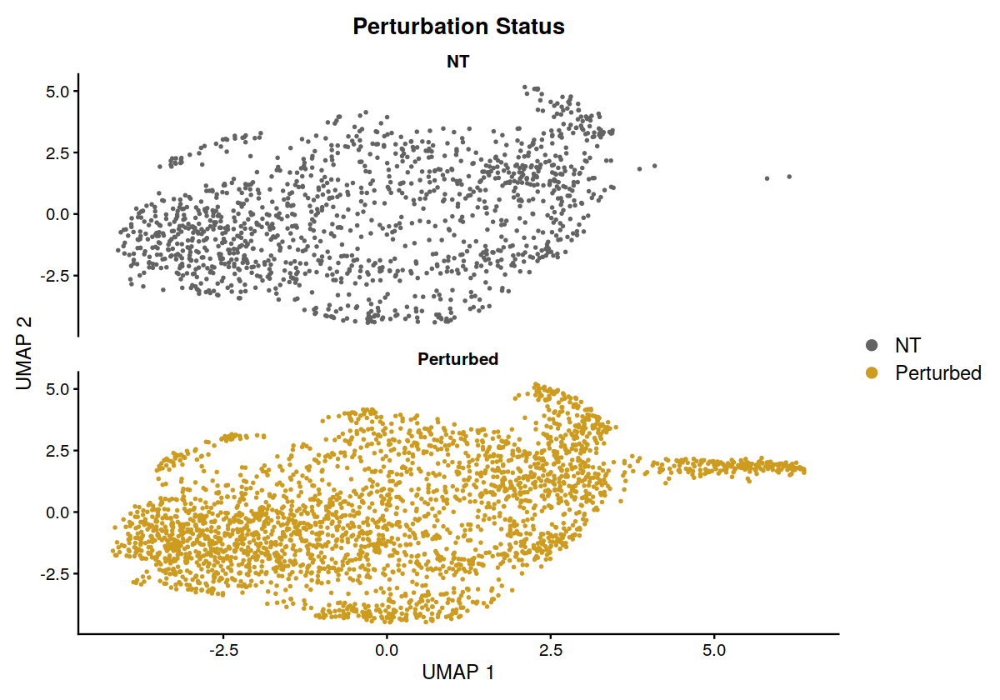

Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities

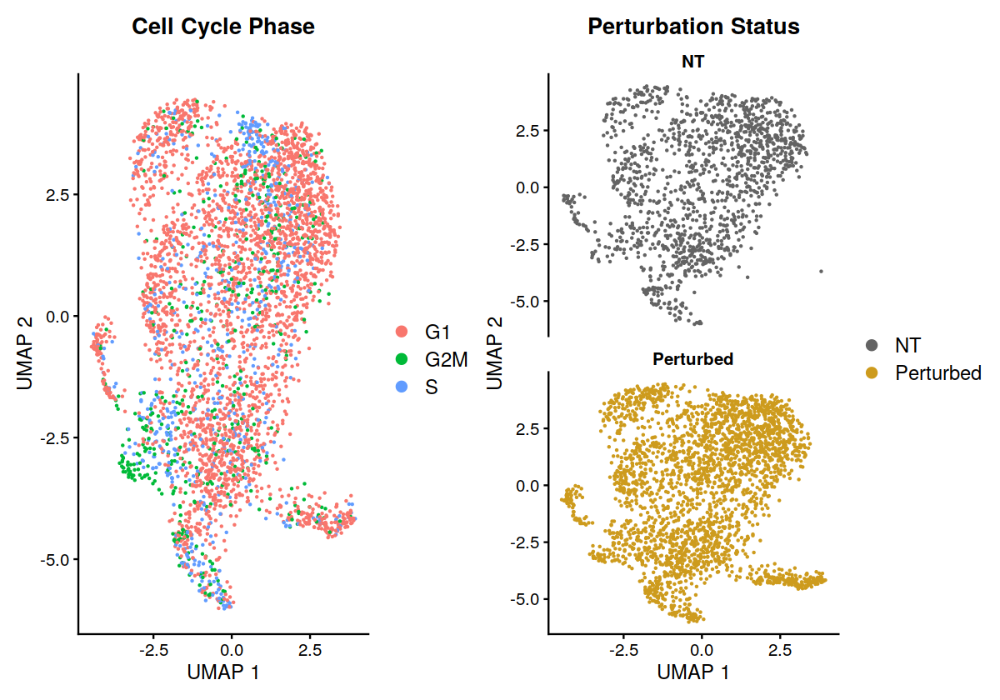

number of iterations= 13 
number of iterations= 12 
number of iterations= 51 
number of iterations= 75 
number of iterations= 220 
number of iterations= 105 
number of iterations= 120 
number of iterations= 174 
number of iterations= 89 
number of iterations= 84 
number of iterations= 110 
number of iterations= 109 
number of iterations= 110 
WARNING! NOT CONVERGENT! 
number of iterations= 5000 
number of iterations= 290 
number of iterations= 225 
number of iterations= 19 
number of iterations= 16 
number of iterations= 434 
number of iterations= 204 
number of iterations= 194 
number of iterations= 320 
number of iterations= 248 
number of iterations= 232 
number of iterations= 143 
number of iterations= 115 
number of iterations= 114 
number of iterations= 384 
number of iterations= 1157 
number of iterations= 157 
number of iterations= 170 
number of iterations= 404 
number of iterations= 222 
number of iterations= 628 
number of iterations= 124 
number of iterations= 497 
number o

The group.by parameter is being deprecated. Please use mixscape.class instead. Setting mixscape.class = mixscape_class and continuing.

Centering and scaling data matrix



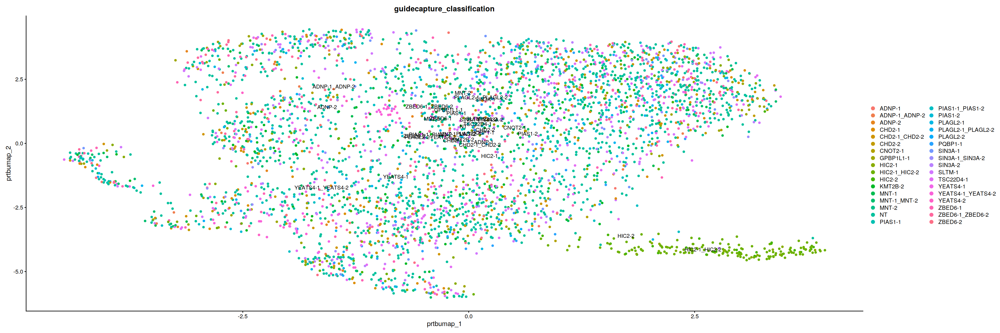

The group.by parameter is being deprecated. Please use mixscape.class instead. Setting mixscape.class = mixscape_class and continuing.

Centering and scaling data matrix



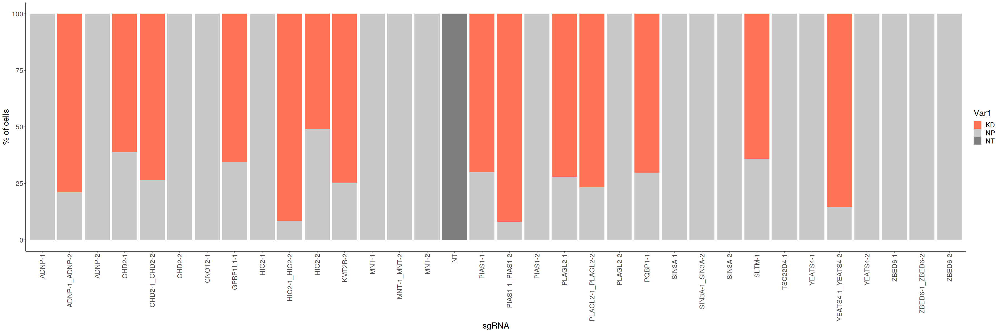

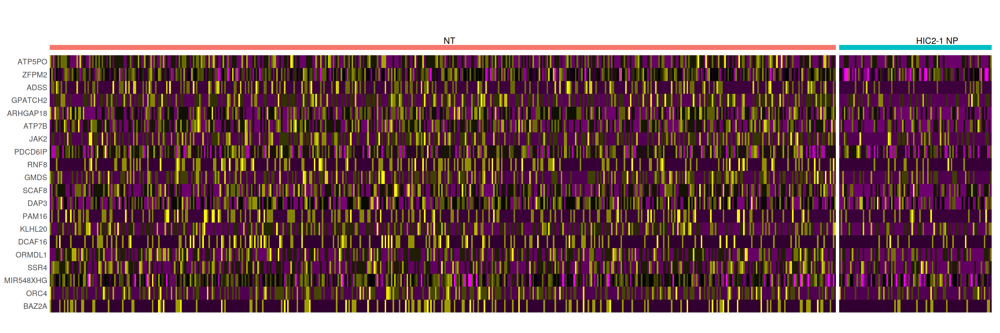

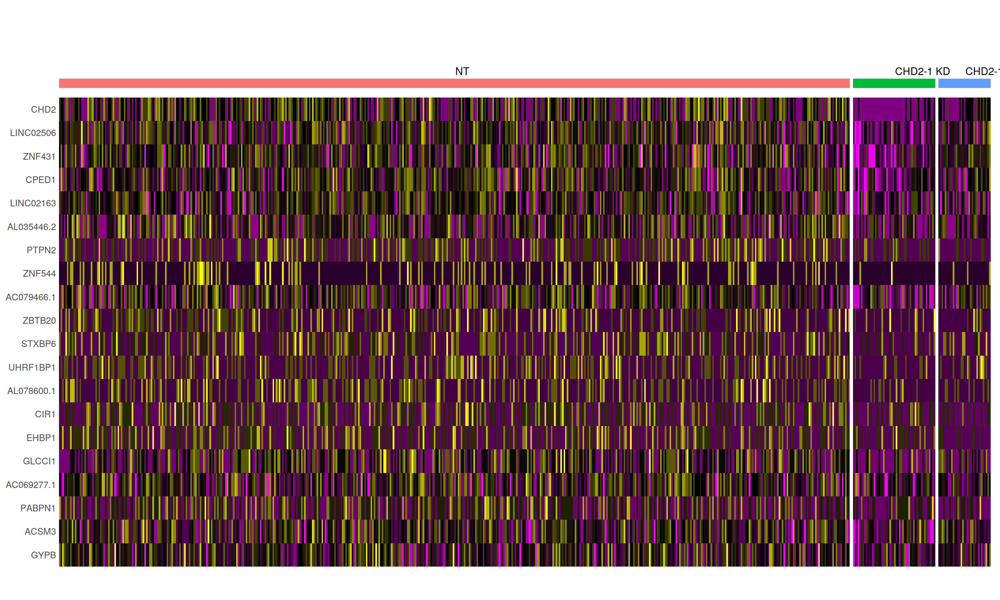

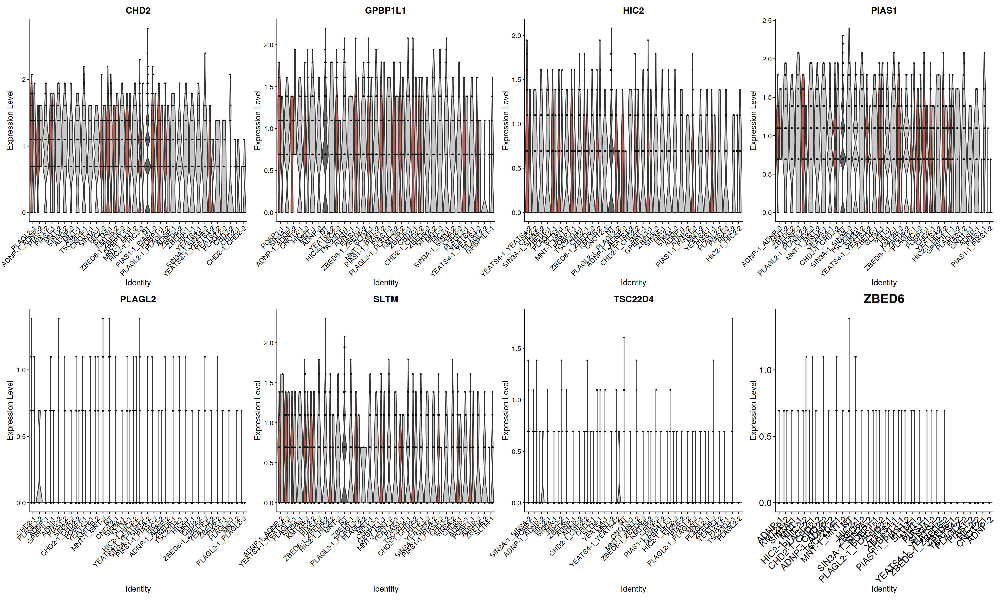

In [209]:
dasa1 <- run_mixscape(dasa1, plot_perturb_score = F)

In [213]:
dasa1_sub <- subset(dasa1, idents = c("KD", "NT"))

dasa1_sub <- MixscapeLDA(
  object = dasa1_sub, 
  assay = "SCT", 
  pc.assay = "PRTB", 
  labels = "guidecapture_classification", 
  nt.label = "NT", 
  npcs = 15, 
  logfc.threshold = 0.2, 
  verbose = F)

# Use LDA results to run UMAP and visualize cells on 2-D. 
# Here, we note that the number of the dimensions to be used is equal to the number of 
# labels minus one (to account for NT cells).

# dasa1_sub <- RunUMAP(
#   object = dasa1_sub,
#   dims = 1:15,
#   reduction = 'lda',
#   reduction.key = 'ldaumap',
#   reduction.name = 'ldaumap')

Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning

ERROR: Error in Embeddings(object[[reduction]])[, dims]: subscript out of bounds


In [214]:
dasa1_sub <- RunUMAP(
  object = dasa1_sub,
  dims = 1:14,
  reduction = 'lda',
  reduction.key = 'ldaumap',
  reduction.name = 'ldaumap')

11:15:41 UMAP embedding parameters a = 0.9922 b = 1.112

11:15:41 Read 2349 rows and found 14 numeric columns

11:15:41 Using Annoy for neighbor search, n_neighbors = 30

11:15:41 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:15:42 Writing NN index file to temp file /tmp/Rtmp9ihv08/file2f1d9d6376a01a

11:15:42 Searching Annoy index using 64 threads, search_k = 3000

11:15:42 Annoy recall = 100%

11:15:43 Commencing smooth kNN distance calibration using 64 threads
 with target n_neighbors = 30

11:15:45 Initializing from normalized Laplacian + noise (using irlba)

11:15:45 Commencing optimization for 500 epochs, with 83106 positive edges

11:15:49 Optimization finished

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, 

In [215]:
table(Idents(dasa1_sub))


  NT   KD 
1316 1033 

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


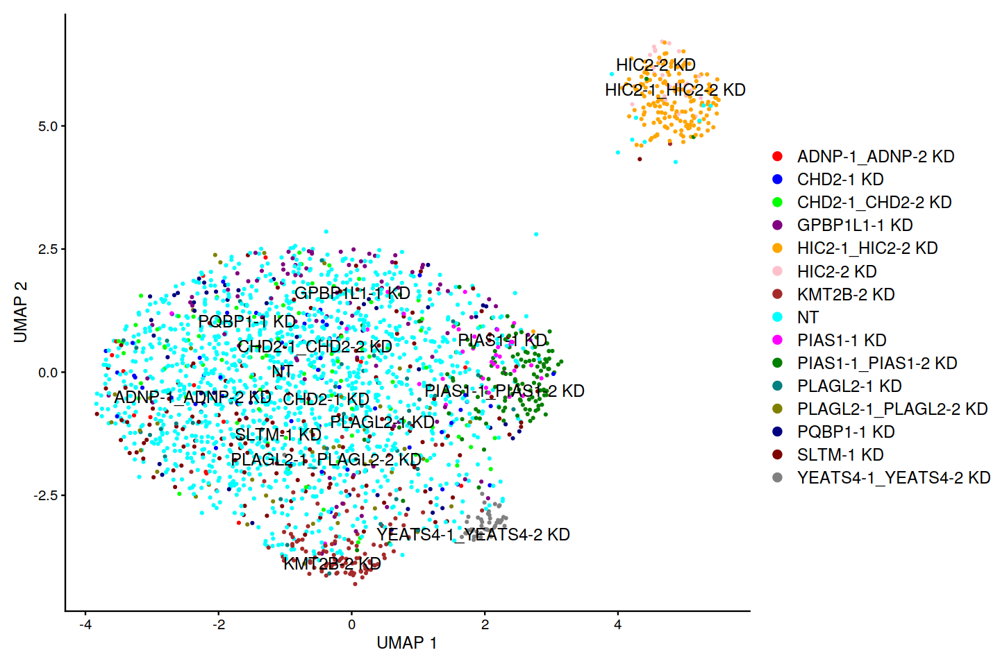

In [226]:
options(repr.plot.width = 12, repr.plot.height = 8)
# Visualize UMAP clustering results.
Idents(dasa1_sub) <- "mixscape_class"
dasa1_sub$mixscape_class <- as.factor(dasa1_sub$mixscape_class)

colors <- c("#FF0000", "#0000FF", "#00FF00", "#800080", "#FFA500", "#FFC0CB", "#A52A2A",
            "#00FFFF", "#FF00FF", "#008000", "#008080", "#808000", "#000080", "#800000",
            "#808080", "#000000", "#FFD700", "#C0C0C0")


# Set colors for each perturbation.
col <- setNames(colors, nm = levels(dasa1_sub$mixscape_class))

p <- DimPlot(object = dasa1_sub, 
             reduction = "ldaumap", 
             repel = TRUE, 
             label.size = 5, 
             label = TRUE, 
             cols = col)

p2 <- p + 
  scale_color_manual(values = col, breaks = levels(dasa1_sub$mixscape_class), drop = FALSE) + 
  ylab("UMAP 2") +
  xlab("UMAP 1") +
  custom_theme

p2

In [217]:
table(dasa1$guidecapture_classification)


           ADNP-1     ADNP-1_ADNP-2            ADNP-2            CHD2-1 
               35                19                22                85 
    CHD2-1_CHD2-2            CHD2-2           CNOT2-1         GPBP1L1-1 
              121                29                34               134 
           HIC2-1     HIC2-1_HIC2-2            HIC2-2           KMT2B-2 
               97               179                49               150 
            MNT-1       MNT-1_MNT-2             MNT-2                NT 
               91               150                48              1316 
          PIAS1-1   PIAS1-1_PIAS1-2           PIAS1-2          PLAGL2-1 
               50               137                54                61 
PLAGL2-1_PLAGL2-2          PLAGL2-2           PQBP1-1           SIN3A-1 
               56                 8                74                39 
  SIN3A-1_SIN3A-2           SIN3A-2            SLTM-1         TSC22D4-1 
               71                52               

In [218]:
table(dasa1$mixscape_class)


           ADNP-1 NP     ADNP-1_ADNP-2 KD     ADNP-1_ADNP-2 NP 
                  35                   15                    4 
           ADNP-2 NP            CHD2-1 KD            CHD2-1 NP 
                  22                   52                   33 
    CHD2-1_CHD2-2 KD     CHD2-1_CHD2-2 NP            CHD2-2 NP 
                  89                   32                   29 
          CNOT2-1 NP         GPBP1L1-1 KD         GPBP1L1-1 NP 
                  34                   88                   46 
           HIC2-1 NP     HIC2-1_HIC2-2 KD     HIC2-1_HIC2-2 NP 
                  97                  164                   15 
           HIC2-2 KD            HIC2-2 NP           KMT2B-2 KD 
                  25                   24                  112 
          KMT2B-2 NP             MNT-1 NP       MNT-1_MNT-2 NP 
                  38                   91                  150 
            MNT-2 NP                   NT           PIAS1-1 KD 
                  48                 13

## DASA2

Processing rep1

Centering data matrix

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from prtbpca to prtbpca_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to prtbpca_”
prtbpca_ 1 
Positive:  RPS12, RPL39, RPS8, RPL37, RPL41, RPL32, RPS23, RPS27, RPS27A, HBZ 
	   RPS18, RPS14, PLCG2, RPS24, RPS15, RPS28, RPL28, RPLP1, RPS29, RPS15A 
	   HBG2, RPL37A, RPL11, RPL19, RPLP2, RPS2, HBG1, RPS21, RPL30, RPS3A 
Negative:  LINC02163, LINC02109, LINC02476, PTH2R, AC008825.1, ZFPM2, AC099520.1, MIR548XHG, AL445255.1, TCF4 
	   DLEU1, LINC02506, AL110292.1, LINC02315, RELN, LINC00355, AP000561.1, AC069277.1, NBAS, IMMP2L 
	   AC090015.1, AL135878.1, NCOA1, AC093515.1, ACSM3, BMP2K, RABGAP1L, LINC01876, CR1L, ITFG1 
prtbpca_ 2 
Positive:  PLCG2, AL627171.2, HES1, HIST1H4C, ID2, AC099520.1, IMMP2L, RPS8, AL445255.1, LINC02315 
	   HIST1H2AG, TEX14, FHIT, SLC25A21, AMD

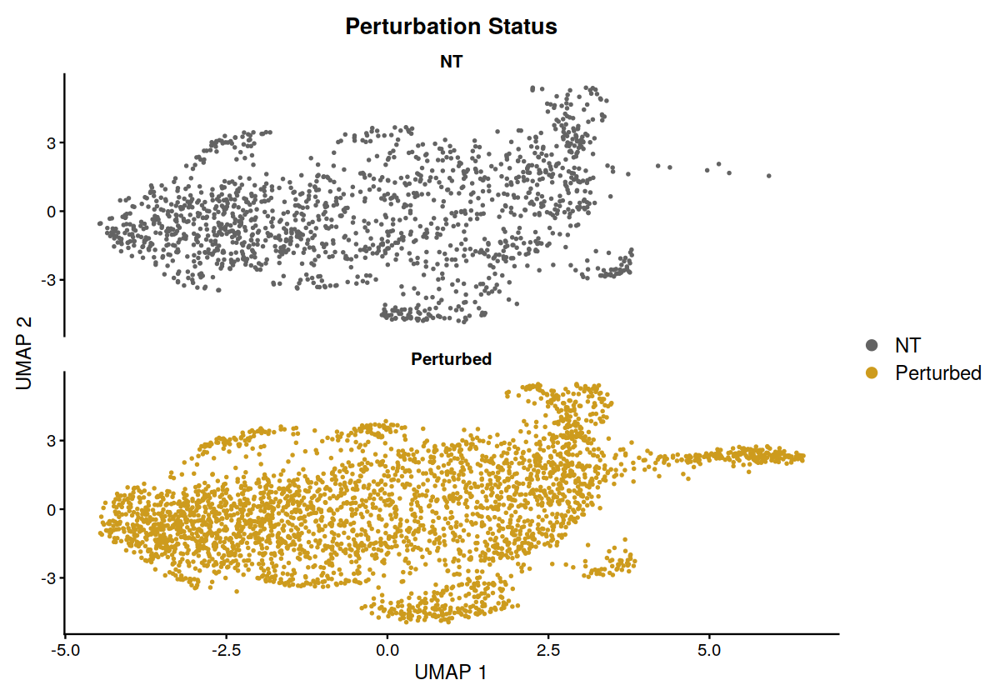

Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The foll

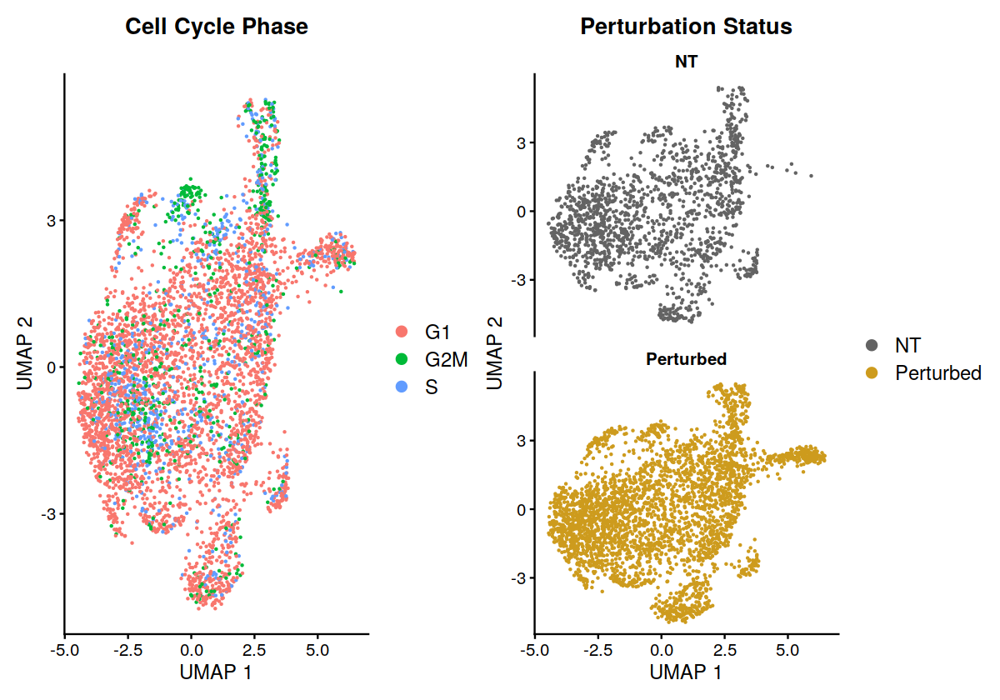

WARNING! NOT CONVERGENT! 
number of iterations= 5000 
number of iterations= 107 
number of iterations= 113 
number of iterations= 118 
number of iterations= 75 
number of iterations= 54 
number of iterations= 49 
number of iterations= 47 
number of iterations= 413 
number of iterations= 254 
number of iterations= 225 
number of iterations= 210 
number of iterations= 362 
number of iterations= 191 
number of iterations= 72 
number of iterations= 57 
number of iterations= 55 
number of iterations= 81 
number of iterations= 37 
number of iterations= 35 
WARNING! NOT CONVERGENT! 
number of iterations= 5000 
number of iterations= 47 
number of iterations= 31 
number of iterations= 31 
number of iterations= 152 
number of iterations= 134 
number of iterations= 134 
number of iterations= 19 
number of iterations= 18 
number of iterations= 121 
number of iterations= 69 
number of iterations= 201 
number of iterations= 159 
number of iterations= 153 
number of iterations= 153 
number of iterati

The group.by parameter is being deprecated. Please use mixscape.class instead. Setting mixscape.class = mixscape_class and continuing.

Centering and scaling data matrix



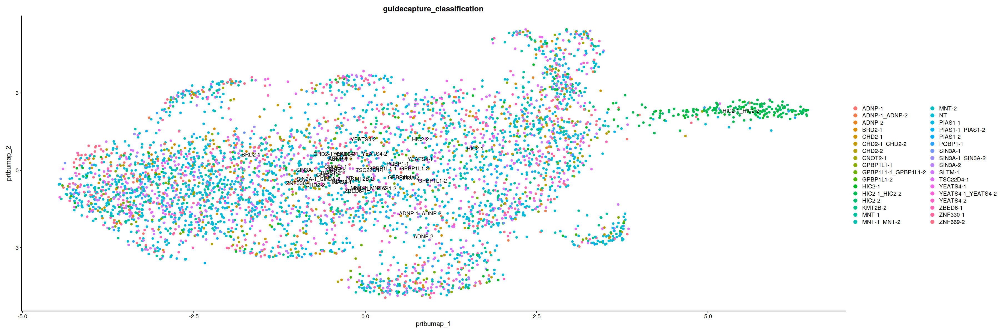

The group.by parameter is being deprecated. Please use mixscape.class instead. Setting mixscape.class = mixscape_class and continuing.

Centering and scaling data matrix



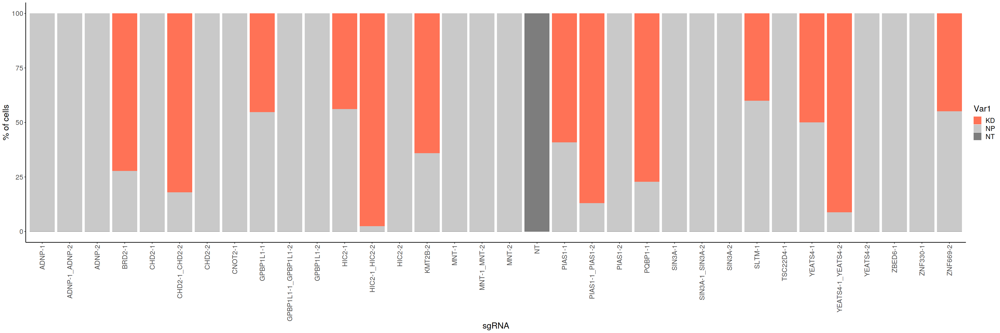

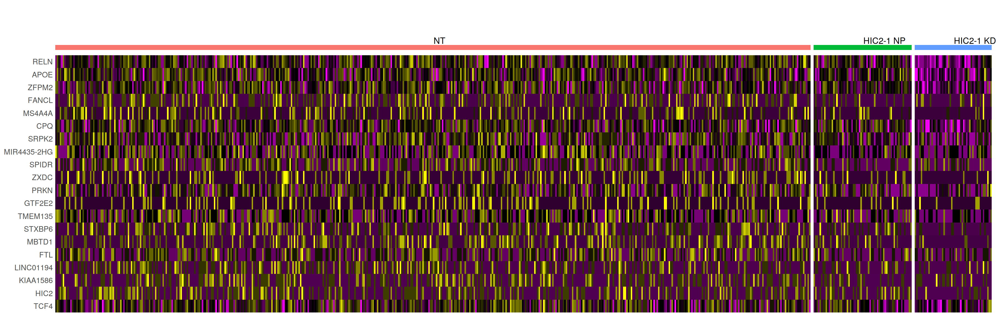

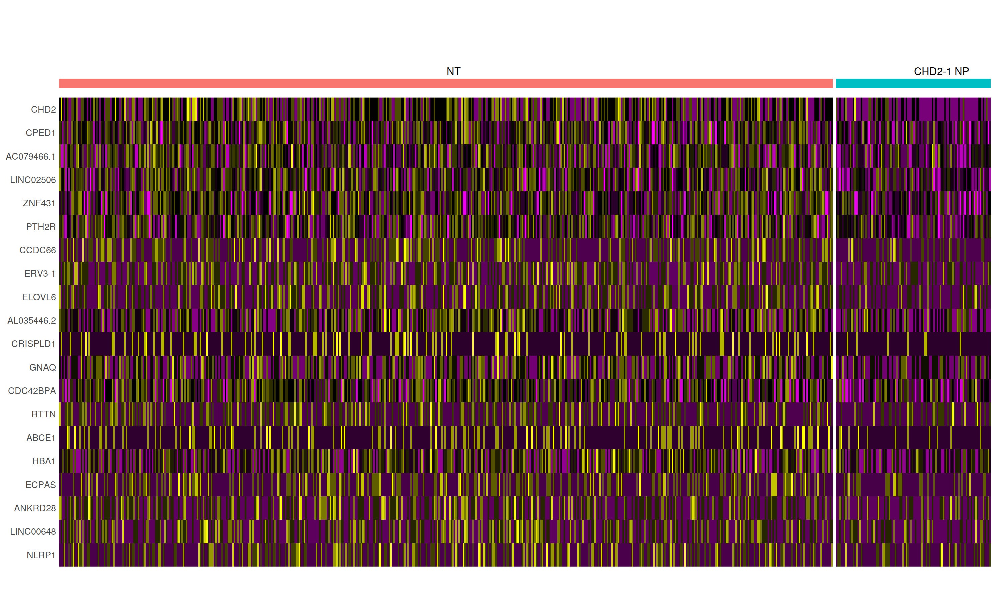

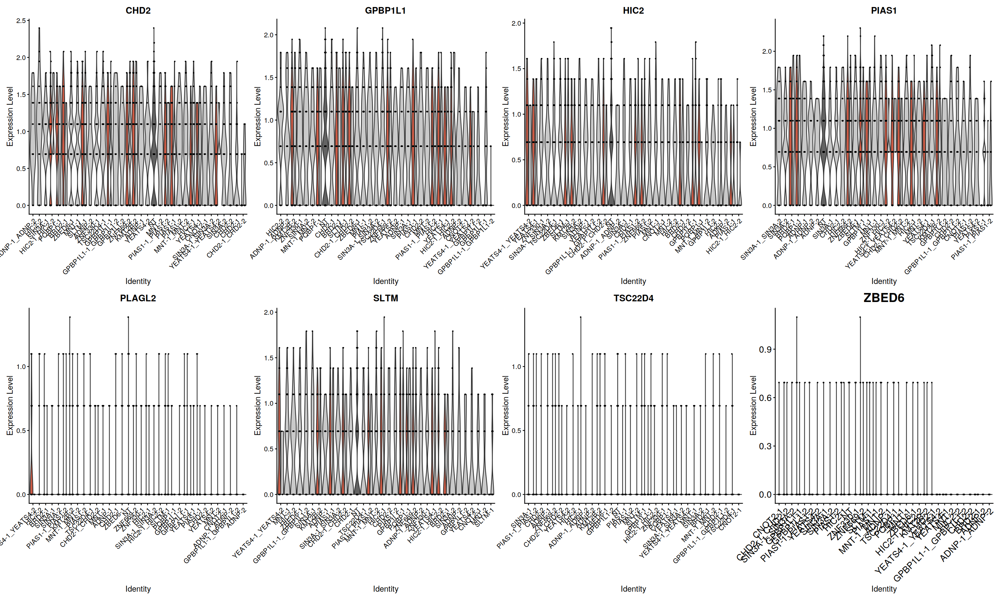

In [210]:
dasa2 <- run_mixscape(dasa2, plot_perturb_score = FALSE)

In [219]:
dasa2_sub <- subset(dasa2, idents = c("KD", "NT"))

dasa2_sub <- MixscapeLDA(
  object = dasa2_sub, 
  assay = "SCT", 
  pc.assay = "PRTB", 
  labels = "guidecapture_classification", 
  nt.label = "NT", 
  npcs = 10, 
  logfc.threshold = 0.2, 
  verbose = F)

# Use LDA results to run UMAP and visualize cells on 2-D. 
# Here, we note that the number of the dimensions to be used is equal to the number of 
# labels minus one (to account for NT cells).

dasa2_sub <- RunUMAP(
  object = dasa2_sub,
  dims = 1:13,
  reduction = 'lda',
  reduction.key = 'ldaumap',
  reduction.name = 'ldaumap')

Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitt

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


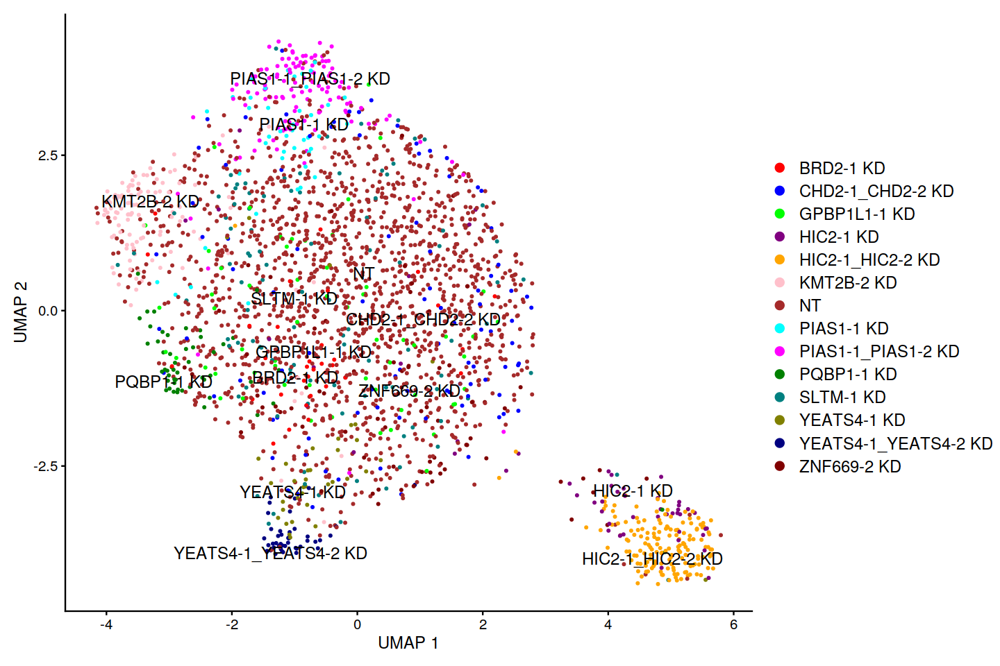

In [230]:
options(repr.plot.width = 12, repr.plot.height = 8)
# Visualize UMAP clustering results.
Idents(dasa2_sub) <- "mixscape_class"
dasa2_sub$mixscape_class <- as.factor(dasa2_sub$mixscape_class)

# Set colors for each perturbation.
col <- setNames(colors, nm = levels(dasa2_sub$mixscape_class))

p <- DimPlot(object = dasa2_sub, 
             reduction = "ldaumap", 
             repel = TRUE, 
             label.size = 5, 
             label = TRUE, 
             cols = col)

p2 <- p + 
  scale_color_manual(values = col, breaks = levels(dasa2_sub$mixscape_class), drop = FALSE) + 
  ylab("UMAP 2") +
  xlab("UMAP 1") +
  custom_theme

p2

## DMSO1

Processing rep1

Centering data matrix

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from prtbpca to prtbpca_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to prtbpca_”
prtbpca_ 1 
Positive:  RPS8, RPLP1, EEF1A1, RPL41, RPS27A, RPS15, RPL19, HSP90AA1, RPS23, RPS12 
	   HSP90AB1, RPS18, RPL37, RPL32, RPS24, FTH1, RPL39, RPS28, RPL37A, RPL28 
	   RPS14, ACTB, RPL13A, RPL7A, RPL8, RPS21, RPL30, RPL14, RPL35, RPS11 
Negative:  XACT, LINC02476, STXBP5, IMMP2L, DIAPH3, AL445255.1, LINC02109, FHIT, SMYD3, AP000561.1 
	   LINC02163, KCNQ5, MIR548XHG, DLEU1, ACSM3, WWOX, RAD51B, LINC01572, MIR924HG, PTH2R 
	   AL110292.1, LRMDA, AC093515.1, SLC25A37, ARL15, EXOC4, TBC1D5, ZFPM2, CPED1, LINC02315 
prtbpca_ 2 
Positive:  MT-ND2, XACT, GYPB, MT-ATP8, MT-ND5, MS4A4A, MT-ND1, GYPA, PTH2R, MT-ND3 
	   GYPE, NDUFC2, PTMA, MT-CYB, APOE, AC246817.2, NCL, COLGALT2, HSPE1, 

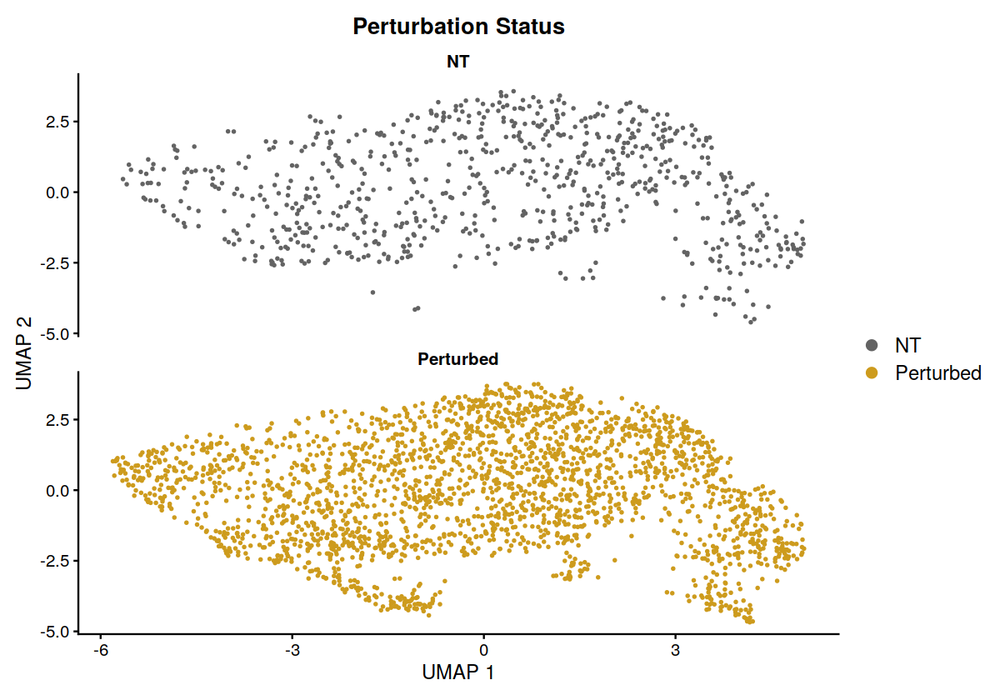

Warning message:
“The following arguments are not used: norm.method”


Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The foll

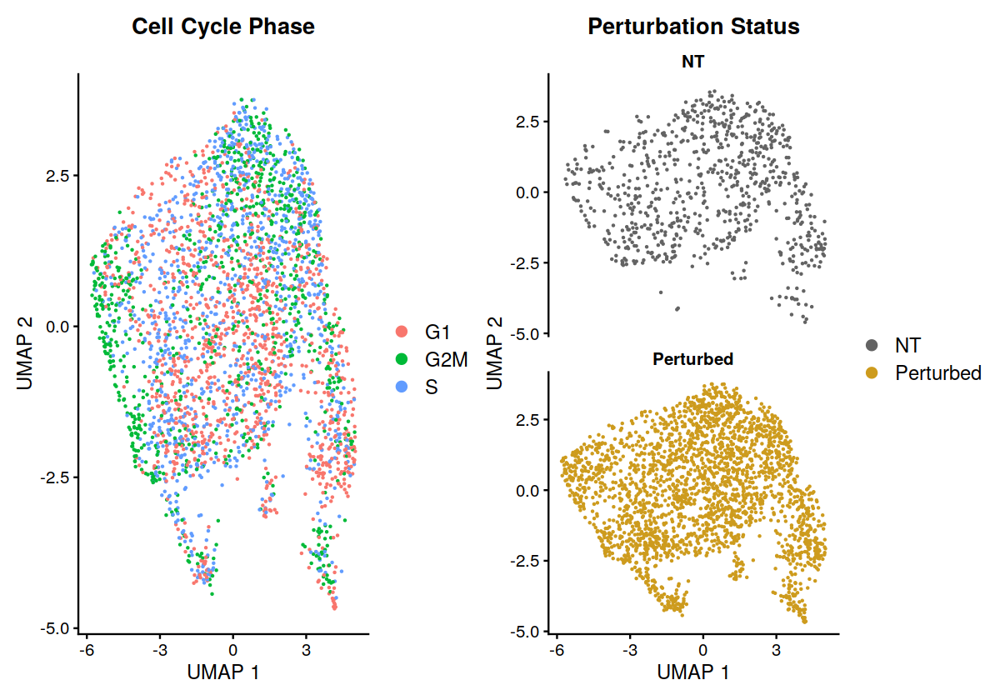

number of iterations= 218 
number of iterations= 168 
number of iterations= 156 
number of iterations= 143 
number of iterations= 71 
number of iterations= 60 
number of iterations= 190 
number of iterations= 100 
number of iterations= 89 
number of iterations= 83 
number of iterations= 142 
number of iterations= 49 
number of iterations= 44 
number of iterations= 63 
number of iterations= 55 
number of iterations= 54 
number of iterations= 245 
number of iterations= 120 
number of iterations= 202 
number of iterations= 18 
number of iterations= 16 
number of iterations= 64 
number of iterations= 17 
number of iterations= 9 
number of iterations= 7 
number of iterations= 100 
number of iterations= 91 
number of iterations= 115 
number of iterations= 133 
number of iterations= 23 
number of iterations= 12 
number of iterations= 12 
number of iterations= 10 
number of iterations= 8 
number of iterations= 62 
number of iterations= 30 
number of iterations= 29 
number of iterations= 100 
n

The group.by parameter is being deprecated. Please use mixscape.class instead. Setting mixscape.class = mixscape_class and continuing.

Centering and scaling data matrix



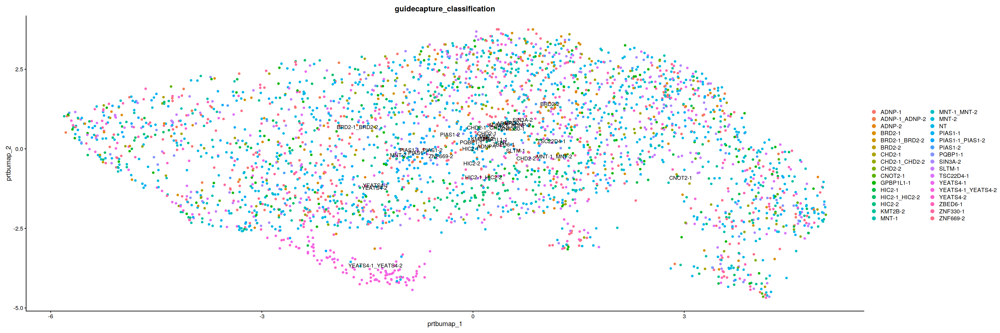

The group.by parameter is being deprecated. Please use mixscape.class instead. Setting mixscape.class = mixscape_class and continuing.

Centering and scaling data matrix



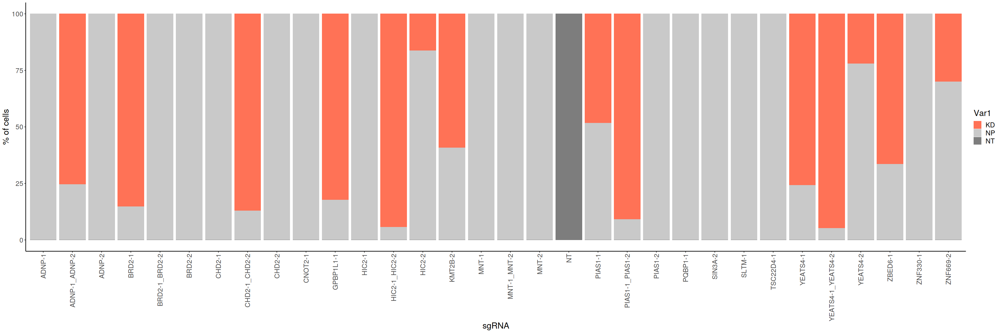

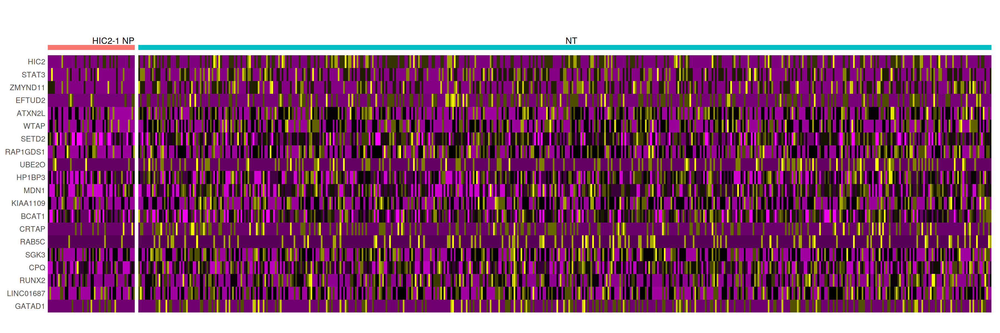

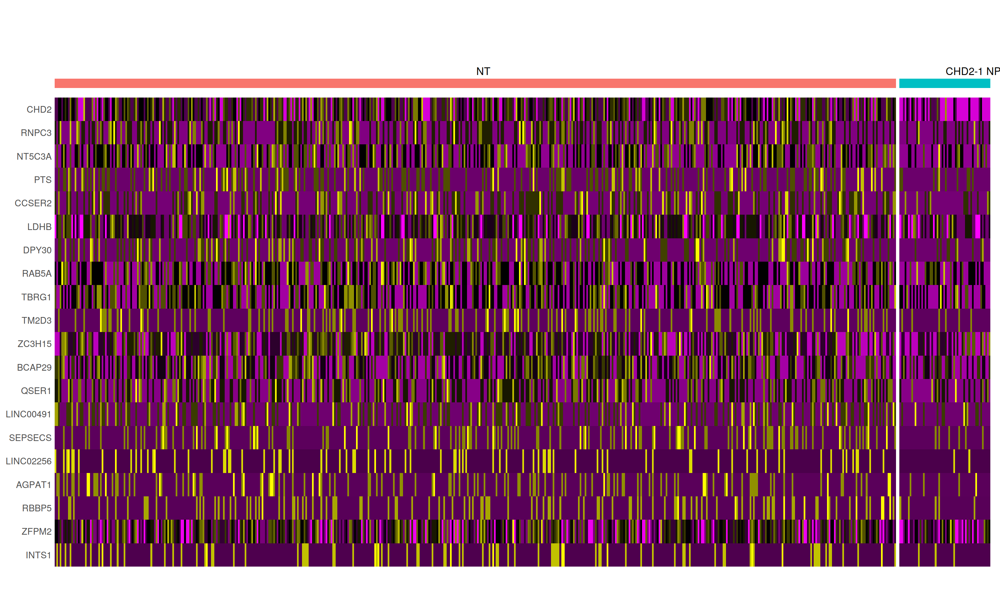

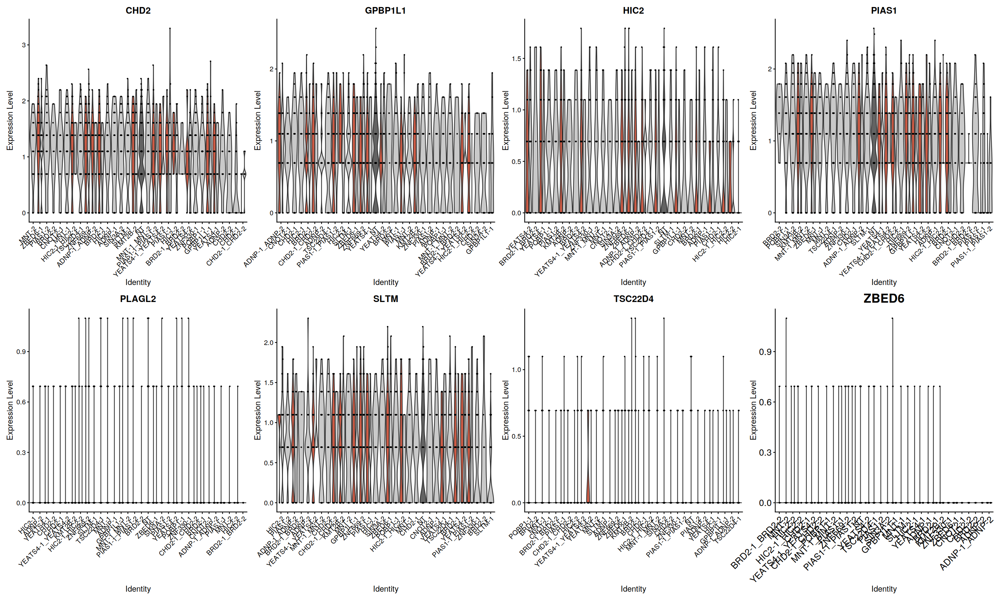

In [211]:
dmso1 <- run_mixscape(dmso1, plot_perturb_score = FALSE)

In [231]:
dmso1_sub <- subset(dmso1, idents = c("KD", "NT"))

dmso1_sub <- MixscapeLDA(
  object = dmso1_sub, 
  assay = "SCT", 
  pc.assay = "PRTB", 
  labels = "guidecapture_classification", 
  nt.label = "NT", 
  npcs = 10, 
  logfc.threshold = 0.2, 
  verbose = F)

# Use LDA results to run UMAP and visualize cells on 2-D. 
# Here, we note that the number of the dimensions to be used is equal to the number of 
# labels minus one (to account for NT cells).

dmso1_sub <- RunUMAP(
  object = dmso1_sub,
  dims = 1:14,
  reduction = 'lda',
  reduction.key = 'ldaumap',
  reduction.name = 'ldaumap')

Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Wa

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


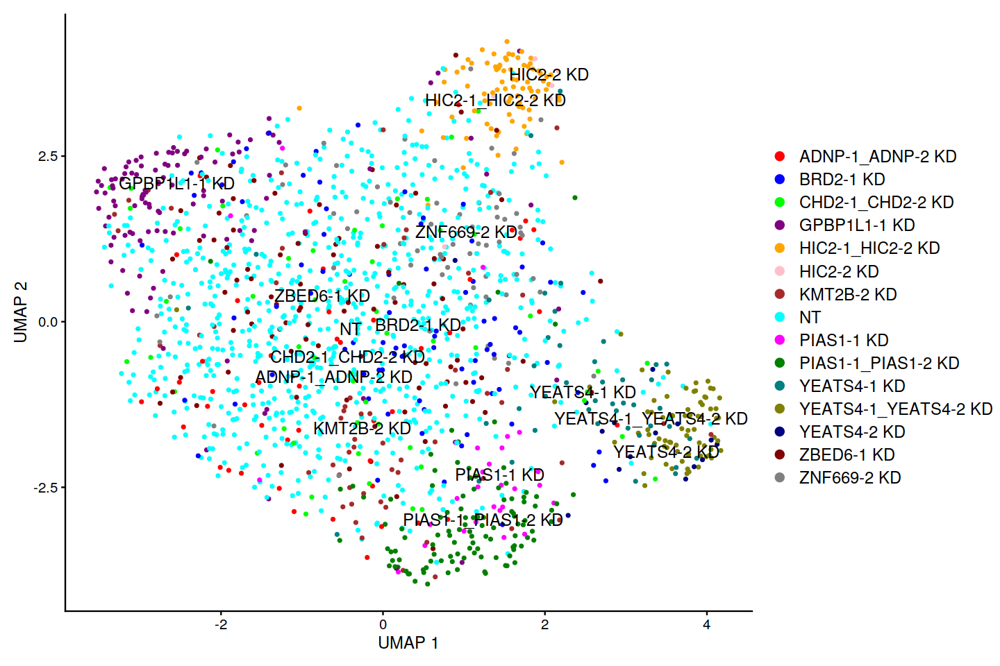

In [232]:
options(repr.plot.width = 12, repr.plot.height = 8)
# Visualize UMAP clustering results.
Idents(dmso1_sub) <- "mixscape_class"
dmso1_sub$mixscape_class <- as.factor(dmso1_sub$mixscape_class)

# Set colors for each perturbation.
col <- setNames(colors, nm = levels(dmso1_sub$mixscape_class))

p <- DimPlot(object = dmso1_sub, 
             reduction = "ldaumap", 
             repel = TRUE, 
             label.size = 5, 
             label = TRUE, 
             cols = col)

p2 <- p + 
  scale_color_manual(values = col, breaks = levels(dmso1_sub$mixscape_class), drop = FALSE) + 
  ylab("UMAP 2") +
  xlab("UMAP 1") +
  custom_theme

p2

## DMSO2

Processing rep1

Centering data matrix

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from prtbpca to prtbpca_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to prtbpca_”
prtbpca_ 1 
Positive:  RPLP1, HSP90AA1, EEF1A1, RPS8, RPL41, RPS27A, RPS15, RPL37, RPS23, RPS12 
	   RPL19, FTH1, RPS18, HSP90AB1, RPS28, RPL39, ACTB, RPL32, RPL28, RPL37A 
	   RPS14, RPS21, VIM, FTL, ACTG1, RPL13A, RPS27, TMSB10, RPS11, RPL35 
Negative:  XACT, LINC02476, IMMP2L, FHIT, STXBP5, AL445255.1, DIAPH3, LINC02163, SMYD3, LINC02109 
	   KCNQ5, AP000561.1, DLEU1, MIR548XHG, RAD51B, PTH2R, ACSM3, CNTNAP2, WWOX, MIR924HG 
	   ARL15, AL110292.1, LINC01572, CPED1, AC079466.1, TBC1D5, ZFPM2, EXOC4, SLC25A37, AC093515.1 
prtbpca_ 2 
Positive:  SLC20A1, BACH2, NEAT1, FLT1, EGR1, TIMP1, BTG2, MALAT1, VIM, GDF15 
	   SQSTM1, IER3, AREG, IER2, TMSB10, CASS4, YES1, TMEM158, VMP1, MARCH3 
	  

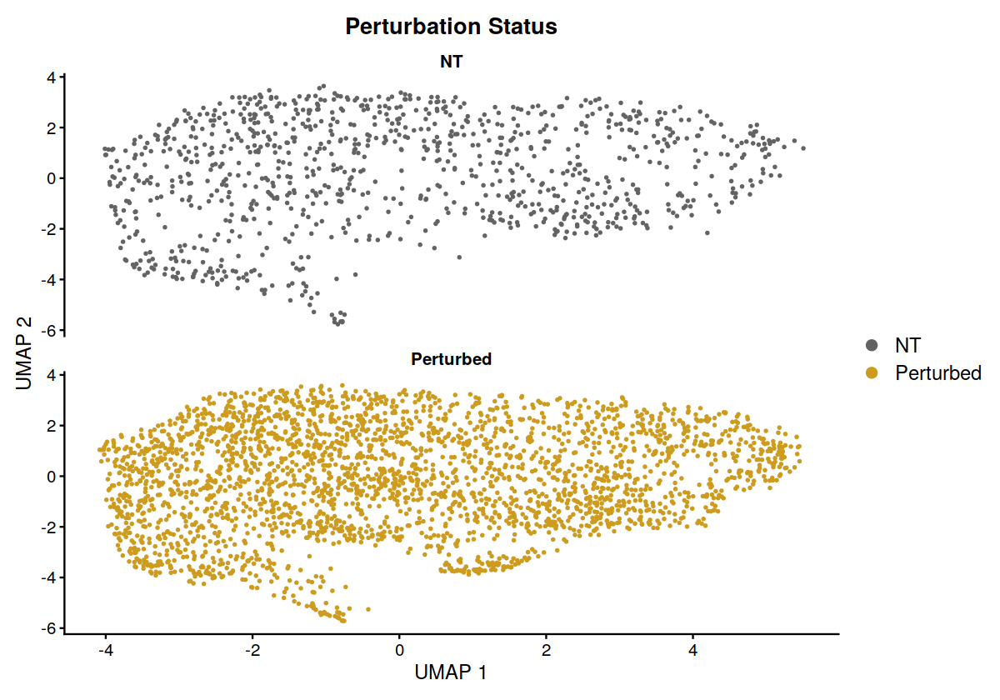

Warning message:
“The following arguments are not used: norm.method”


Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“

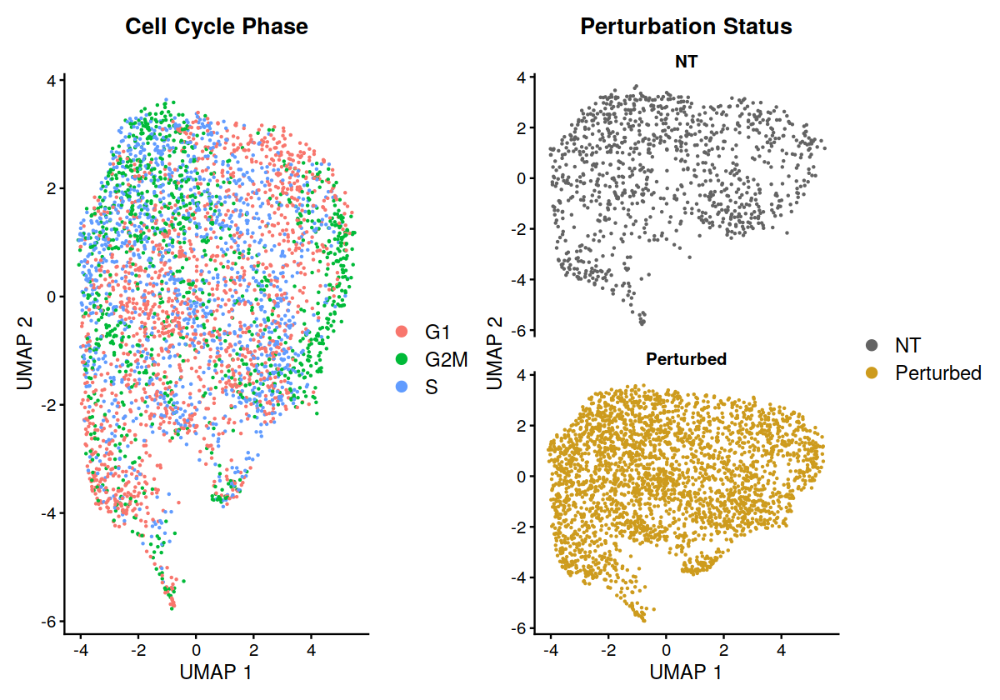

number of iterations= 85 
number of iterations= 25 
number of iterations= 11 
number of iterations= 6 
number of iterations= 84 
number of iterations= 71 
number of iterations= 39 
number of iterations= 37 
number of iterations= 36 
number of iterations= 640 
number of iterations= 118 
number of iterations= 278 
number of iterations= 156 
number of iterations= 150 
number of iterations= 39 
number of iterations= 34 
number of iterations= 34 
number of iterations= 34 
number of iterations= 534 
number of iterations= 138 
number of iterations= 139 
number of iterations= 137 
number of iterations= 136 
number of iterations= 135 
number of iterations= 65 
number of iterations= 23 
number of iterations= 11 
number of iterations= 8 
number of iterations= 7 
number of iterations= 17 
number of iterations= 13 
number of iterations= 273 
number of iterations= 277 
number of iterations= 242 
number of iterations= 234 
number of iterations= 62 
number of iterations= 55 
number of iterations= 79 


The group.by parameter is being deprecated. Please use mixscape.class instead. Setting mixscape.class = mixscape_class and continuing.

Centering and scaling data matrix



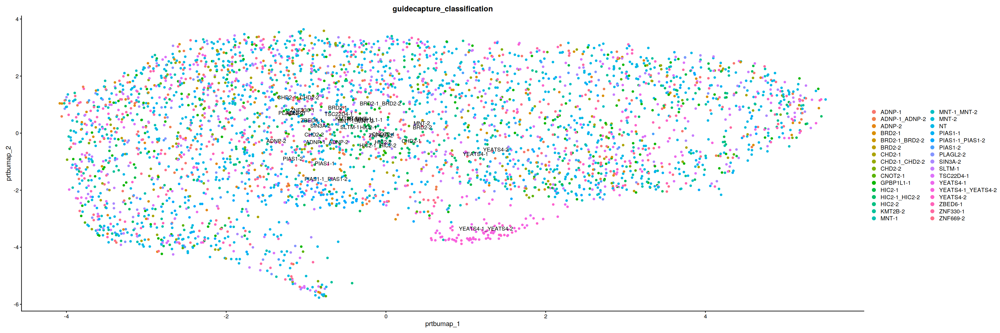

The group.by parameter is being deprecated. Please use mixscape.class instead. Setting mixscape.class = mixscape_class and continuing.

Centering and scaling data matrix



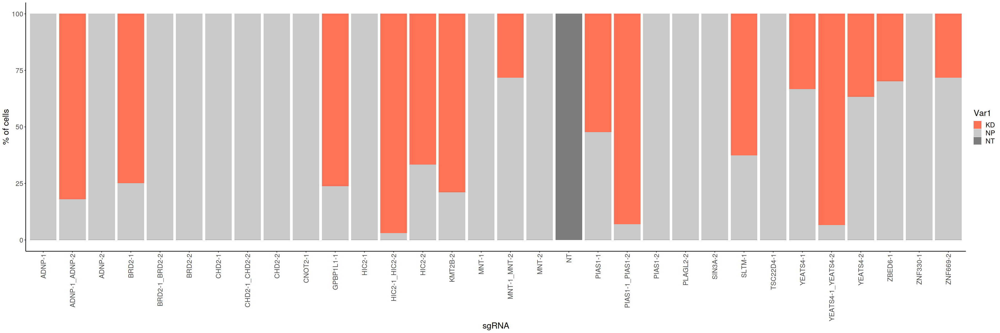

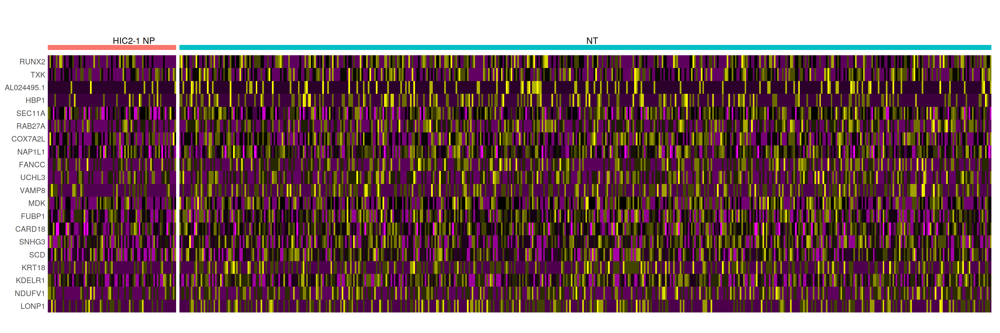

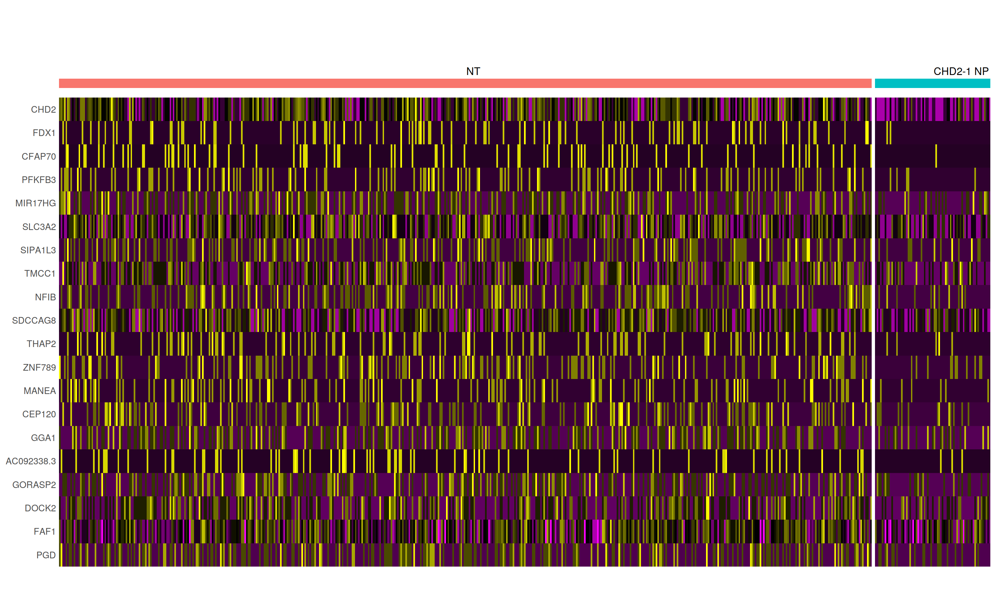

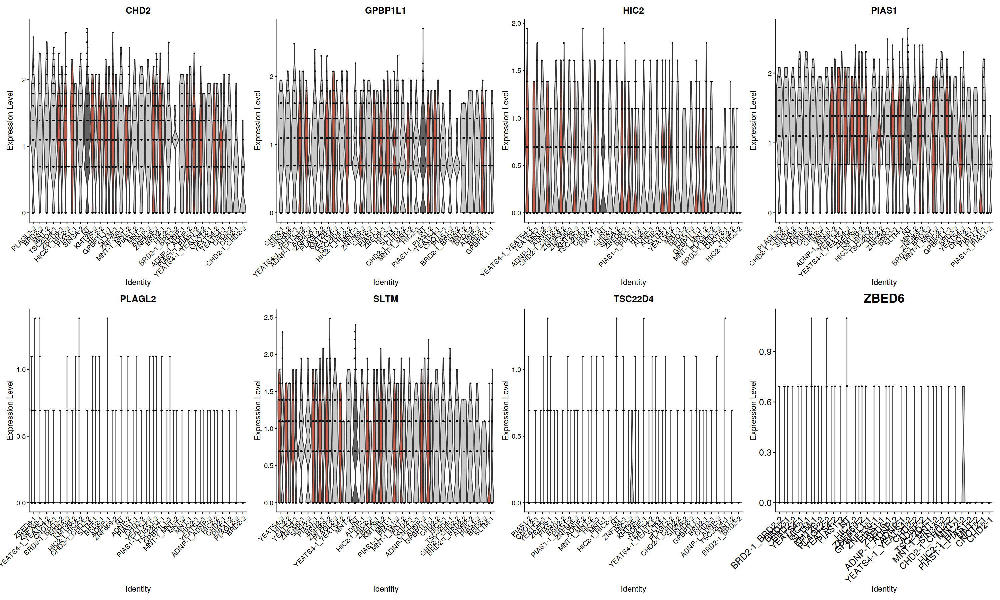

In [212]:
dmso2 <- run_mixscape(dmso2, plot_perturb_score = FALSE) # can not plot perturb score with this sample, assuming since HIC2 change is so small

In [233]:
dmso2_sub <- subset(dmso2, idents = c("KD", "NT"))

dmso2_sub <- MixscapeLDA(
  object = dmso2_sub, 
  assay = "SCT", 
  pc.assay = "PRTB", 
  labels = "guidecapture_classification", 
  nt.label = "NT", 
  npcs = 10, 
  logfc.threshold = 0.2, 
  verbose = F)

# Use LDA results to run UMAP and visualize cells on 2-D. 
# Here, we note that the number of the dimensions to be used is equal to the number of 
# labels minus one (to account for NT cells).

dmso2_sub <- RunUMAP(
  object = dmso2_sub,
  dims = 1:15,
  reduction = 'lda',
  reduction.key = 'ldaumap',
  reduction.name = 'ldaumap')

Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”


Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“The following arguments are not used: norm.method”
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”
Wa

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


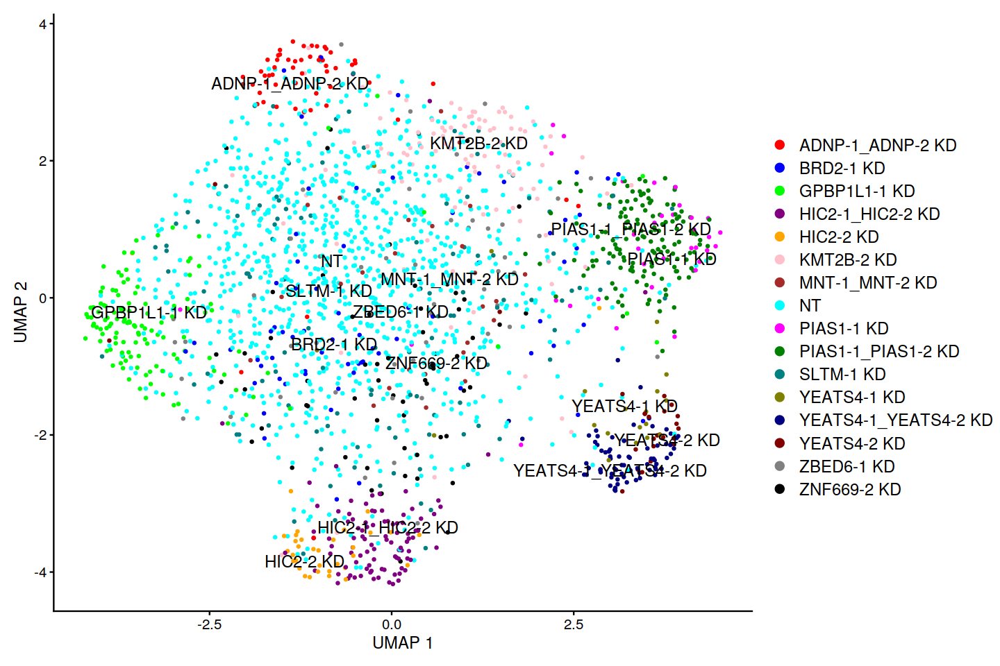

In [234]:
options(repr.plot.width = 12, repr.plot.height = 8)
# Visualize UMAP clustering results.
Idents(dmso2_sub) <- "mixscape_class"
dmso2_sub$mixscape_class <- as.factor(dmso2_sub$mixscape_class)

# Set colors for each perturbation.
col <- setNames(colors, nm = levels(dmso2_sub$mixscape_class))

p <- DimPlot(object = dmso2_sub, 
             reduction = "ldaumap", 
             repel = TRUE, 
             label.size = 5, 
             label = TRUE, 
             cols = col)

p2 <- p + 
  scale_color_manual(values = col, breaks = levels(dmso2_sub$mixscape_class), drop = FALSE) + 
  ylab("UMAP 2") +
  xlab("UMAP 1") +
  custom_theme

p2

## Save objects

In [235]:
# save subs, objects that have had cc genes regressed out and have been mixscape filtered
saveRDS(dasa1_sub, file = "DASA1/seurat/06_mixscape_cc_filtered_DASA1_ngc.rds")
saveRDS(dasa2_sub, file = "DASA2/seurat/06_mixscape_cc_filtered_DASA2_ngc.rds")
saveRDS(dmso1_sub, file = "DMSO1/seurat/06_mixscape_cc_filtered_DMSO1_ngc.rds")
saveRDS(dmso2_sub, file = "DMSO2/seurat/06_mixscape_cc_filtered_DMSO2_ngc.rds")